# SWMT sector comparisson between simulations

Compares local changes in SWMT in different sectors of the Southern ocean, to check which sectors drive increases and decreases in DSW formation between simulations

In [1]:
%matplotlib inline
%config InlineBackend.figure_format='retina'

import xarray as xr
import numpy as np
import dask.array
import cosima_cookbook as cc
from gsw import alpha, SA_from_SP, p_from_z, CT_from_pt, beta, sigma0
# note these gsw numpy functions mean some care is needed to avoid memory issues in very high-res analysis 

import warnings
warnings.filterwarnings('ignore') #ignoring 10% trash warning

## plotting
import matplotlib.pyplot as plt
from matplotlib import gridspec
import cmocean.cm as cmo
import matplotlib.colors as col
import cartopy.crs as ccrs
import matplotlib.path as mpath
from matplotlib import rc
rc('text', usetex=True)
rc('xtick', labelsize=25) 
rc('ytick', labelsize=25) 
rc('axes', labelsize=25) 

In [2]:
## once you've set up a dask-worker, connect to it, click the dashboard link to check worker status
from dask.distributed import Client
client = Client()
client

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: /proxy/8787/status,
Dashboard: /proxy/8787/status,Workers: 7
Total threads: 28,Total memory: 251.20 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:37459,Workers: 7
Dashboard: /proxy/8787/status,Total threads: 28
Started: Just now,Total memory: 251.20 GiB
Comm: tcp://127.0.0.1:40725,Total threads: 4
Dashboard: /proxy/37485/status,Memory: 35.89 GiB
Nanny: tcp://127.0.0.1:41003,


Importing integrated SWMT in sections

In [3]:
dir='/home/156/wf4500/v45_wf4500/DSW_collaborative/sigma0_SWMT/'
figpath='/home/156/wf4500/v45_wf4500/DSW_collaborative/sigma0_SWMT/figs/'

In [4]:
#Experiments are
c21mbath='01deg_jra55v13_ryf9091_21mbath'
CM2atm='01deg_jra55v13_ryf9091_21mbath_CM2atm'
r5mdz='01deg_jra55v13_ryf9091_21mbath_5mdz'
r5mtop='ryf_5mtoponly'

# Imports
c21mbath_data=xr.open_dataset(dir+c21mbath+'/bysector/SWMT_bysector_shelf.nc')
CM2atm_data=xr.open_dataset(dir+CM2atm+'/bysector/SWMT_bysector_shelf.nc')
r5mdz_data=xr.open_dataset(dir+r5mdz+'/bysector/SWMT_bysector_shelf.nc')
r5mtop_data=xr.open_dataset(dir+r5mtop+'/bysector/SWMT_bysector_shelf.nc')

How are the sectors defined?

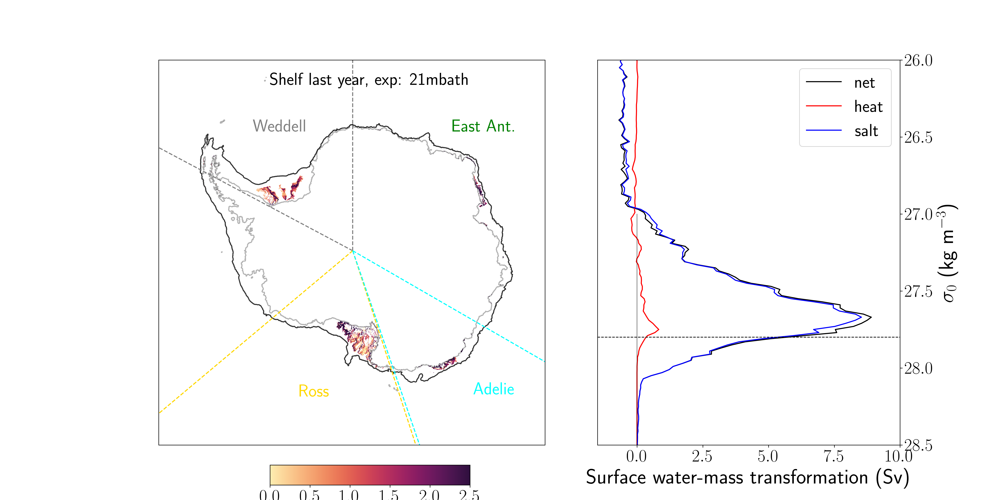

In [5]:
# show here figure produced in the SWMT plot
from IPython.display import Image
Image(filename='/g/data/v45/wf4500/DSW_collaborative/sigma0_SWMT/figs/SWMTshelfmaps_21mbath_sigma0_total.png')

Curves by sector, by simulation

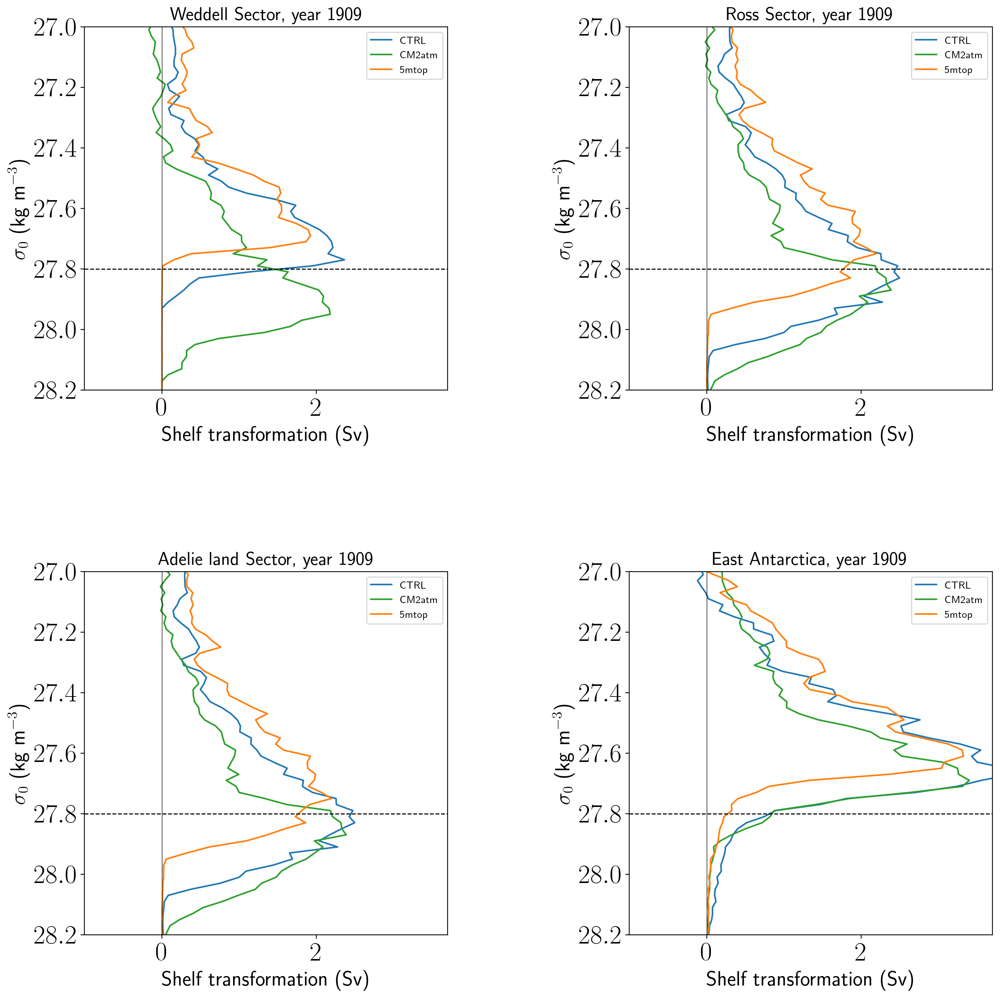

In [6]:
figure = plt.figure(num = 1, figsize = (15, 15))
plt.subplots_adjust(left=0.1,
                    bottom=0.1,
                    right=0.9,
                    top=0.9,
                    wspace=0.5,
                    hspace=0.5)

iso_max=27.8

plt.subplot(2,2,1)

plt.plot(c21mbath_data.Weddell_shelf.isel(time=-1),c21mbath_data.isopycnal_bins,label='CTRL',color='tab:blue')
plt.plot(CM2atm_data.Weddell_shelf.isel(time=-1),CM2atm_data.isopycnal_bins,label='CM2atm',color='tab:green')
plt.plot(r5mtop_data.Weddell_shelf.isel(time=-1),r5mtop_data.isopycnal_bins,label='5mtop',color='tab:orange')

plt.plot([-1,10],[iso_max,iso_max],'--',color='black',lw=1);
plt.plot([0, 0], [29,24], 'k', linewidth=0.5)
plt.ylim((28.2,27)); plt.xlim(-1,3.7)
plt.ylabel(r'$\sigma_0$ (kg m$^{-3}$)', fontsize = 20)
plt.xlabel('Shelf transformation (Sv)', fontsize = 20)
plt.legend()
plt.title('Weddell Sector, year 1909', fontsize=18)





plt.subplot(2,2,2)

plt.plot(c21mbath_data.Ross_shelf.isel(time=-1),c21mbath_data.isopycnal_bins,label='CTRL',color='tab:blue')
plt.plot(CM2atm_data.Ross_shelf.isel(time=-1),CM2atm_data.isopycnal_bins,label='CM2atm',color='tab:green')
plt.plot(r5mtop_data.Ross_shelf.isel(time=-1),r5mtop_data.isopycnal_bins,label='5mtop',color='tab:orange')

plt.plot([-1,10],[iso_max,iso_max],'--',color='black',lw=1);
plt.plot([0, 0], [29,24], 'k', linewidth=0.5)
plt.ylim((28.2,27)); plt.xlim(-1,3.7)
plt.ylabel(r'$\sigma_0$ (kg m$^{-3}$)', fontsize = 20)
plt.xlabel('Shelf transformation (Sv)', fontsize = 20)
plt.legend()
plt.title('Ross Sector, year 1909', fontsize=18)


plt.subplot(2,2,3)

plt.plot(c21mbath_data.Adelie_shelf.isel(time=-1),c21mbath_data.isopycnal_bins,label='CTRL',color='tab:blue')
plt.plot(CM2atm_data.Adelie_shelf.isel(time=-1),CM2atm_data.isopycnal_bins,label='CM2atm',color='tab:green')
plt.plot(r5mtop_data.Adelie_shelf.isel(time=-1),r5mtop_data.isopycnal_bins,label='5mtop',color='tab:orange')

plt.plot([-1,10],[iso_max,iso_max],'--',color='black',lw=1);
plt.plot([0, 0], [29,24], 'k', linewidth=0.5)
plt.ylim((28.2,27)); plt.xlim(-1,3.7)
plt.ylabel(r'$\sigma_0$ (kg m$^{-3}$)', fontsize = 20)
plt.xlabel('Shelf transformation (Sv)', fontsize = 20)
plt.legend()
plt.title('Adelie land Sector, year 1909', fontsize=18)



plt.subplot(2,2,4)

plt.plot(c21mbath_data.East_Antarctic_shelf.isel(time=-1),c21mbath_data.isopycnal_bins,label='CTRL',color='tab:blue')
plt.plot(CM2atm_data.East_Antarctic_shelf.isel(time=-1),CM2atm_data.isopycnal_bins,label='CM2atm',color='tab:green')
plt.plot(r5mtop_data.East_Antarctic_shelf.isel(time=-1),r5mtop_data.isopycnal_bins,label='5mtop',color='tab:orange')

plt.plot([-1,10],[iso_max,iso_max],'--',color='black',lw=1);
plt.plot([0, 0], [29,24], 'k', linewidth=0.5)
plt.ylim((28.2,27)); plt.xlim(-1,3.7)
plt.ylabel(r'$\sigma_0$ (kg m$^{-3}$)', fontsize = 20)
plt.xlabel('Shelf transformation (Sv)', fontsize = 20)
plt.legend()
plt.title('East Antarctica, year 1909', fontsize=18)

plt.savefig(figpath+'SWMTsimulations_comp_by_sector_sigma0_total.png',dpi=300)

**CM2ATM:** Notice that in Weddellm Ross sea and Adelie land sectors, we find that the SWMT curve in CM2ATM goes towards denser values when comapred to the CTRL, with the stronger movement happening in the Weddell Sector. Exception here is East Antarctica that looks more or less equal ( although transformation towards lighter waters also seem to be enhanced - which could be hinting towards a stronger overturning circulation)

**5mtop:** In all sectors the curve moves towards lighter values when compared to the control, therefore showing that reducing teh vertical resolution results in decreased DSW formation in all sectors

Are the differences seen here caused by changes in heat or salt/freshwater fluxes? lets compare each case

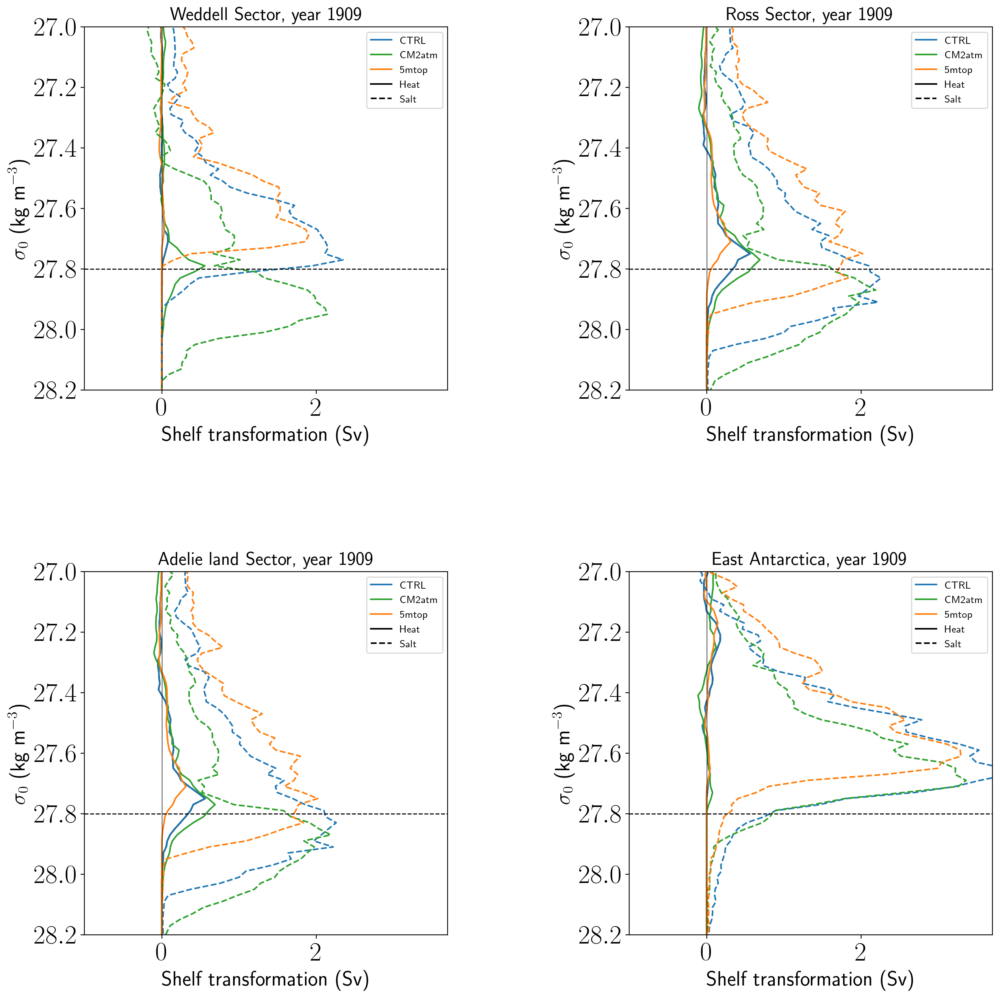

In [7]:
figure = plt.figure(num = 1, figsize = (15, 15))
plt.subplots_adjust(left=0.1,
                    bottom=0.1,
                    right=0.9,
                    top=0.9,
                    wspace=0.5,
                    hspace=0.5)

iso_max=27.8

plt.subplot(2,2,1)

plt.plot(c21mbath_data.Weddell_heat_shelf.isel(time=-1),c21mbath_data.isopycnal_bins,label='CTRL',color='tab:blue')
plt.plot(CM2atm_data.Weddell_heat_shelf.isel(time=-1),CM2atm_data.isopycnal_bins,label='CM2atm',color='tab:green')
plt.plot(r5mtop_data.Weddell_heat_shelf.isel(time=-1),r5mtop_data.isopycnal_bins,label='5mtop',color='tab:orange')
plt.plot(c21mbath_data.Weddell_salt_shelf.isel(time=-1),c21mbath_data.isopycnal_bins,'--',color='tab:blue')
plt.plot(CM2atm_data.Weddell_salt_shelf.isel(time=-1),CM2atm_data.isopycnal_bins,'--',color='tab:green')
plt.plot(r5mtop_data.Weddell_salt_shelf.isel(time=-1),r5mtop_data.isopycnal_bins,'--',color='tab:orange')
plt.plot(c21mbath_data.Weddell_heat_shelf.isel(time=-1),c21mbath_data.isopycnal_bins,label='Heat',color='black',zorder=0)
plt.plot(c21mbath_data.Weddell_heat_shelf.isel(time=-1),c21mbath_data.isopycnal_bins,'--',label='Salt',color='black',zorder=1)


plt.plot([-1,10],[iso_max,iso_max],'--',color='black',lw=1);
plt.plot([0, 0], [29,24], 'k', linewidth=0.5)
plt.ylim((28.2,27)); plt.xlim(-1,3.7)
plt.ylabel(r'$\sigma_0$ (kg m$^{-3}$)', fontsize = 20)
plt.xlabel('Shelf transformation (Sv)', fontsize = 20)
plt.legend()
plt.title('Weddell Sector, year 1909', fontsize=18)


plt.subplot(2,2,2)

plt.plot(c21mbath_data.Ross_heat_shelf.isel(time=-1),c21mbath_data.isopycnal_bins,label='CTRL',color='tab:blue')
plt.plot(CM2atm_data.Ross_heat_shelf.isel(time=-1),CM2atm_data.isopycnal_bins,label='CM2atm',color='tab:green')
plt.plot(r5mtop_data.Ross_heat_shelf.isel(time=-1),r5mtop_data.isopycnal_bins,label='5mtop',color='tab:orange')
plt.plot(c21mbath_data.Ross_salt_shelf.isel(time=-1),c21mbath_data.isopycnal_bins,'--',color='tab:blue')
plt.plot(CM2atm_data.Ross_salt_shelf.isel(time=-1),CM2atm_data.isopycnal_bins,'--',color='tab:green')
plt.plot(r5mtop_data.Ross_salt_shelf.isel(time=-1),r5mtop_data.isopycnal_bins,'--',color='tab:orange')
plt.plot(c21mbath_data.Ross_heat_shelf.isel(time=-1),c21mbath_data.isopycnal_bins,label='Heat',color='black',zorder=0)
plt.plot(c21mbath_data.Ross_heat_shelf.isel(time=-1),c21mbath_data.isopycnal_bins,'--',label='Salt',color='black',zorder=1)


plt.plot([-1,10],[iso_max,iso_max],'--',color='black',lw=1);
plt.plot([0, 0], [29,24], 'k', linewidth=0.5)
plt.ylim((28.2,27)); plt.xlim(-1,3.7)
plt.ylabel(r'$\sigma_0$ (kg m$^{-3}$)', fontsize = 20)
plt.xlabel('Shelf transformation (Sv)', fontsize = 20)
plt.legend()
plt.title('Ross Sector, year 1909', fontsize=18)


plt.subplot(2,2,3)

plt.plot(c21mbath_data.Adelie_heat_shelf.isel(time=-1),c21mbath_data.isopycnal_bins,label='CTRL',color='tab:blue')
plt.plot(CM2atm_data.Adelie_heat_shelf.isel(time=-1),CM2atm_data.isopycnal_bins,label='CM2atm',color='tab:green')
plt.plot(r5mtop_data.Adelie_heat_shelf.isel(time=-1),r5mtop_data.isopycnal_bins,label='5mtop',color='tab:orange')
plt.plot(c21mbath_data.Adelie_salt_shelf.isel(time=-1),c21mbath_data.isopycnal_bins,'--',color='tab:blue')
plt.plot(CM2atm_data.Adelie_salt_shelf.isel(time=-1),CM2atm_data.isopycnal_bins,'--',color='tab:green')
plt.plot(r5mtop_data.Adelie_salt_shelf.isel(time=-1),r5mtop_data.isopycnal_bins,'--',color='tab:orange')
plt.plot(c21mbath_data.Adelie_heat_shelf.isel(time=-1),c21mbath_data.isopycnal_bins,label='Heat',color='black',zorder=0)
plt.plot(c21mbath_data.Adelie_heat_shelf.isel(time=-1),c21mbath_data.isopycnal_bins,'--',label='Salt',color='black',zorder=1)


plt.plot([-1,10],[iso_max,iso_max],'--',color='black',lw=1);
plt.plot([0, 0], [29,24], 'k', linewidth=0.5)
plt.ylim((28.2,27)); plt.xlim(-1,3.7)
plt.ylabel(r'$\sigma_0$ (kg m$^{-3}$)', fontsize = 20)
plt.xlabel('Shelf transformation (Sv)', fontsize = 20)
plt.legend()
plt.title('Adelie land Sector, year 1909', fontsize=18)


plt.subplot(2,2,4)

plt.plot(c21mbath_data.East_Antarctic_heat_shelf.isel(time=-1),c21mbath_data.isopycnal_bins,label='CTRL',color='tab:blue')
plt.plot(CM2atm_data.East_Antarctic_heat_shelf.isel(time=-1),CM2atm_data.isopycnal_bins,label='CM2atm',color='tab:green')
plt.plot(r5mtop_data.East_Antarctic_heat_shelf.isel(time=-1),r5mtop_data.isopycnal_bins,label='5mtop',color='tab:orange')
plt.plot(c21mbath_data.East_Antarctic_salt_shelf.isel(time=-1),c21mbath_data.isopycnal_bins,'--',color='tab:blue')
plt.plot(CM2atm_data.East_Antarctic_salt_shelf.isel(time=-1),CM2atm_data.isopycnal_bins,'--',color='tab:green')
plt.plot(r5mtop_data.East_Antarctic_salt_shelf.isel(time=-1),r5mtop_data.isopycnal_bins,'--',color='tab:orange')
plt.plot(c21mbath_data.East_Antarctic_heat_shelf.isel(time=-1),c21mbath_data.isopycnal_bins,label='Heat',color='black',zorder=0)
plt.plot(c21mbath_data.East_Antarctic_heat_shelf.isel(time=-1),c21mbath_data.isopycnal_bins,'--',label='Salt',color='black',zorder=1)


plt.plot([-1,10],[iso_max,iso_max],'--',color='black',lw=1);
plt.plot([0, 0], [29,24], 'k', linewidth=0.5)
plt.ylim((28.2,27)); plt.xlim(-1,3.7)
plt.ylabel(r'$\sigma_0$ (kg m$^{-3}$)', fontsize = 20)
plt.xlabel('Shelf transformation (Sv)', fontsize = 20)
plt.legend()
plt.title('East Antarctica, year 1909', fontsize=18)

plt.savefig(figpath+'SWMTsimulations_comp_by_sector_HEATandSALT_sigma0_total.png',dpi=300)

Most of the changes seen in SWMT seem to be driven by salt/freshwater fluxes.  It might then be worth to calculate the difference of Salinities in the bottom of the shelf of each simulation

## SALINITY ANOMALIES ON THE SHELF

Salinity, FW seem to drive the changes we see in DSW formation between simulations. Lets see how salinity anomalies are at the surface and at the bottom of the shelf in each simulation. This will help us verify which locations of the shelf get saltier, so we can isolate from where the increased density signal would come from.

In [8]:
gdata_db='/home/156/wf4500/databases/access/DSW.db'
temporary_db='/home/156/wf4500/databases/access/temporary_DSW.db'

session = cc.database.create_session(gdata_db)
temp_session = cc.database.create_session(temporary_db)

Setting a shelf and depth mask for the experiments

In [9]:
def shelf_mask_isobath(var):
    '''
    Masks ACCESS-OM2-01 variables by the region polewards of the 1000m isobath as computed using 
    a script contributed by Adele Morrison.
    Only to be used with ACCESS-OM2-0.1 output!
    '''
    contour_file = np.load('/g/data/ik11/grids/Antarctic_slope_contour_1000m.npz')
    
    shelf_mask = contour_file['contour_masked_above']
    yt_ocean = contour_file['yt_ocean']
    xt_ocean = contour_file['xt_ocean']
    
    # in this file the points along the isobath are given a positive value, the points outside (northwards) 
    # of the isobath are given a value of -100 and all the points on the continental shelf have a value of 0 
    # so we mask for the 0 values 
    shelf_mask[np.where(shelf_mask!=0)] = np.nan
    shelf_mask = shelf_mask+1
    shelf_map  = np.nan_to_num(shelf_mask)
    shelf_mask = xr.DataArray(shelf_mask, coords = [('yt_ocean', yt_ocean), ('xt_ocean', xt_ocean)])
    shelf_map  = xr.DataArray(shelf_map,  coords = [('yt_ocean', yt_ocean), ('xt_ocean', xt_ocean)])
    
    # then we want to multiply the variable with the mask so we need to account for the shape of the mask. 
    # The mask uses a northern cutoff of 59S.
    masked_var = var.sel(yt_ocean = slice(-90, -59.03)) * shelf_mask

    return masked_var, shelf_map

In [10]:
#ctrl case
ht = cc.querying.getvar('01deg_jra55v13_ryf9091_21mbath', 'ht', session, n=1) 
ht = ht.sel(yt_ocean = slice(-90, -50))
ht_21mbath=ht
land_mask_21mbath = (ht_21mbath*0).fillna(1)

yt_ocean = ht.yt_ocean.values
xt_ocean = ht.xt_ocean.values
ht_shelf_21mbath, shelf_mask_21mbath = shelf_mask_isobath(ht_21mbath)



#5mtop case
ht_5mtop= cc.querying.getvar('ryf_5mtoponly', 'ht', temp_session, n=1) 
ht_5mtop = ht_5mtop.sel(yt_ocean = slice(-90, -50))
land_mask_5mtop = (ht_5mtop*0).fillna(1)


ht_shelf_5mtop, shelf_mask_5mtop = shelf_mask_isobath(ht_5mtop)



#ht and amsks for CM2atm are the same as the one from CTRL case

Importing salinities in the last year of simulations

In [11]:
start_time='1909-01'
end_time='1909-12'

Sal_21mbath = cc.querying.getvar('01deg_jra55v13_ryf9091_21mbath', 'salt', session, frequency='1 monthly',start_time=start_time, end_time=end_time).sel(time=slice(start_time, end_time))    
Sal_CM2atm = cc.querying.getvar('01deg_jra55v13_ryf9091_21mbath_CM2atm', 'salt', session, frequency='1 monthly',start_time=start_time, end_time=end_time).sel(time=slice(start_time, end_time))
Sal_5mtop = cc.querying.getvar('ryf_5mtoponly', 'salt', temp_session, frequency='1 monthly',start_time=start_time, end_time=end_time).sel(time=slice(start_time, end_time))

Obtaining salinity on the Bottom

In [12]:
# 21mbath/ctrl
depth_array = Sal_21mbath * 0 + Sal_21mbath.st_ocean
max_depth = depth_array.max(dim = 'st_ocean', skipna= True)
sob_21mbath = Sal_21mbath.where(depth_array.st_ocean >= max_depth)
sob_21mbath = sob_21mbath.sum(dim = 'st_ocean')


# CM2atm
depth_array = Sal_CM2atm * 0 + Sal_CM2atm.st_ocean
max_depth = depth_array.max(dim = 'st_ocean', skipna= True)
sob_CM2atm = Sal_CM2atm.where(depth_array.st_ocean >= max_depth)
sob_CM2atm = sob_CM2atm.sum(dim = 'st_ocean')


# 5mtop
depth_array = Sal_5mtop * 0 + Sal_5mtop.st_ocean
max_depth = depth_array.max(dim = 'st_ocean', skipna= True)
sob_5mtop = Sal_5mtop.where(depth_array.st_ocean >= max_depth)
sob_5mtop = sob_5mtop.sum(dim = 'st_ocean')

In [13]:
sob_21mbath = sob_21mbath.load()
sob_CM2atm = sob_CM2atm.load()
sob_5mtop = sob_5mtop.load()

ht_21mbath=ht_21mbath.load()
land_mask_21mbath=land_mask_21mbath.load()
ht_shelf_21mbath=ht_shelf_21mbath.load()
shelf_mask_21mbath=shelf_mask_21mbath.load()

ht_5mtop=ht_5mtop.load()
land_mask_5mtop=land_mask_5mtop.load()
shelf_mask_5mtop=shelf_mask_5mtop.load()
ht_shelf_5mtop=ht_shelf_5mtop.load()

/g/data/hh5/public/apps/miniconda3/envs/analysis3-23.07/lib/python3.10/site-packages/dask/array/reductions.py:651: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)
/g/data/hh5/public/apps/miniconda3/envs/analysis3-23.07/lib/python3.10/site-packages/dask/array/reductions.py:651: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)
/g/data/hh5/public/apps/miniconda3/envs/analysis3-23.07/lib/python3.10/site-packages/dask/array/reductions.py:651: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)
/g/data/hh5/public/apps/miniconda3/envs/analysis3-23.07/lib/python3.10/site-packages/dask/array/reductions.py:651: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(x_chunk, axis=axis, keepdims=keepdims)
/g/data/hh5/public/apps/miniconda3/envs/analysis3-23.07/lib/python3.10/site-packages/dask/array/reductions.py:651: RuntimeWarning: All-NaN s

In [14]:
lat_slice=slice(-90,-50)

In [15]:
sob_21mbath_winter=sob_21mbath.isel(time=slice(6,9)).mean('time').sel(yt_ocean=lat_slice)
sob_CM2atm_winter=sob_CM2atm.isel(time=slice(6,9)).mean('time').sel(yt_ocean=lat_slice)
sob_5mtop_winter=sob_5mtop.isel(time=slice(6,9)).mean('time').sel(yt_ocean=lat_slice)


In [16]:
ht_21mbath = cc.querying.getvar('01deg_jra55v13_ryf9091_21mbath','ht' , session,n=1).sel(yt_ocean=lat_slice)
land_mask_21mbath = np.squeeze(ht_21mbath.values)*0
land_mask_21mbath[np.isnan(land_mask_21mbath)] = 1
land_mask_21mbath = np.where(land_mask_21mbath==1,land_mask_21mbath,np.nan)
land_mask_masked_21mbath = np.ma.masked_where((land_mask_21mbath==0),land_mask_21mbath)
# make land go all the way to -90S:
land_mask_lat_21mbath = ht_21mbath.yt_ocean.values
land_mask_lat_21mbath[0] = -90



ht_5mtop = cc.querying.getvar('ryf_5mtoponly','ht' , temp_session,n=1).sel(yt_ocean=lat_slice)
land_mask_5mtop = np.squeeze(ht_5mtop.values)*0
land_mask_5mtop[np.isnan(land_mask_5mtop)] = 1
land_mask_5mtop = np.where(land_mask_5mtop==1,land_mask_5mtop,np.nan)
land_mask_masked_5mtop = np.ma.masked_where((land_mask_5mtop==0),land_mask_5mtop)
# make land go all the way to -90S:
land_mask_lat_5mtop = ht_5mtop.yt_ocean.values
land_mask_lat_5mtop[0] = -90

In [17]:
ht_21mbath = cc.querying.getvar('01deg_jra55v13_ryf9091_21mbath','ht' , session,n=1).sel(yt_ocean=lat_slice)
land_mask_21mbath = np.squeeze(ht_21mbath.values)*0
land_mask_21mbath[np.isnan(land_mask_21mbath)] = 1
land_mask_21mbath = np.where(land_mask_21mbath==1,land_mask_21mbath,np.nan)
land_mask_masked_21mbath = np.ma.masked_where((land_mask_21mbath==0),land_mask_21mbath)
# make land go all the way to -90S:
land_mask_lat_21mbath = ht_21mbath.yt_ocean.values
land_mask_lat_21mbath[0] = -90


In [18]:
ht_21mbath_mask = cc.querying.getvar('01deg_jra55v13_ryf9091_21mbath','ht' , session,n=1).sel(yt_ocean=slice(-82,-50))
ht_21mbath_mask=ht_21mbath_mask.fillna(0)
ht_21mbath_mask=ht_21mbath_mask.where(ht_21mbath_mask<=1000)*0

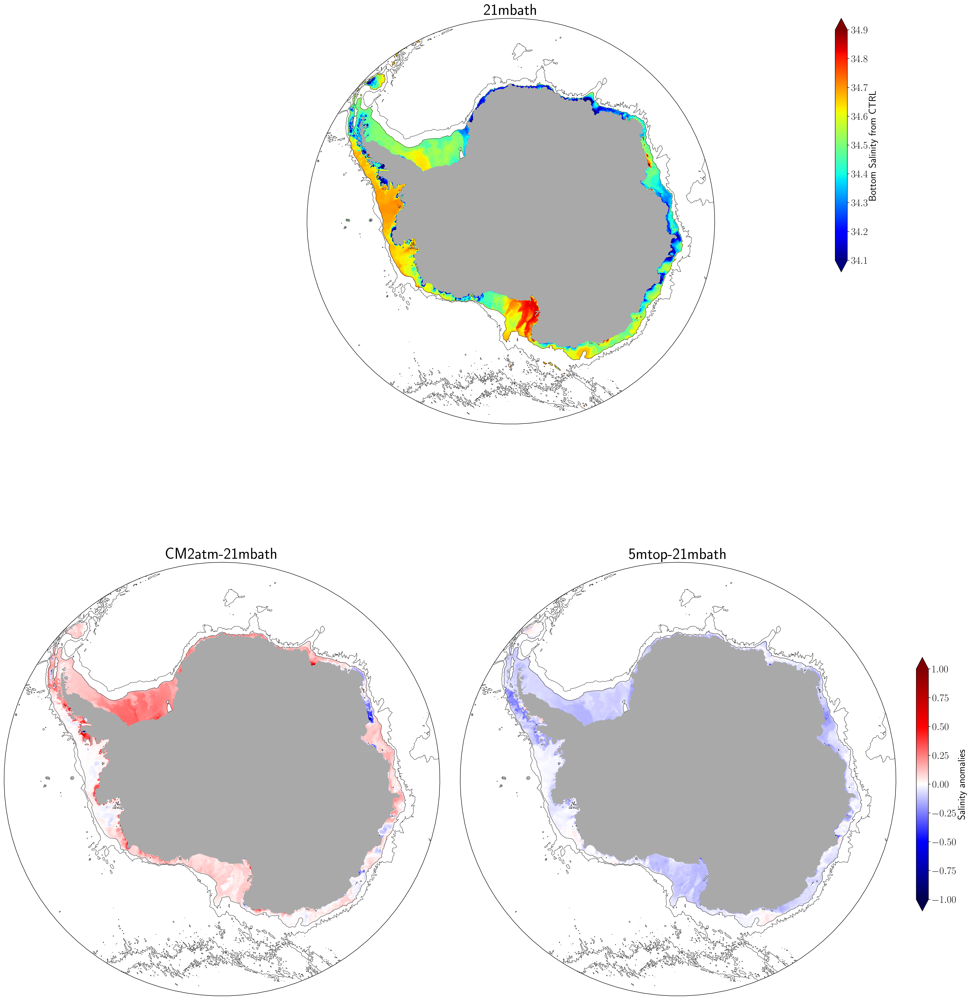

In [19]:
# Bottom salinity comparisson

scale_max = 1
fontsize=18

fig  = plt.figure(1, figsize = (25,25))
norm = col.Normalize(vmin=-scale_max,vmax=scale_max)
normctrl = col.Normalize(vmin=34.1,vmax=34.9)
# Reference Salinity on the Bottom
# setup stereo projection:
ax = fig.add_axes([0.0, 0.6, 1, 0.4],projection=ccrs.SouthPolarStereo())
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)
# plot:
cf = ax.pcolormesh(sob_21mbath_winter.xt_ocean, sob_21mbath_winter.yt_ocean, sob_21mbath_winter + ht_21mbath_mask, norm = normctrl, 
                   cmap = 'jet', transform = ccrs.PlateCarree())
ax.contour(ht_21mbath.xt_ocean,ht_21mbath.yt_ocean,ht_21mbath,levels=[1000,3000],colors='k',linewidths=0.5,transform = ccrs.PlateCarree())
plt.title('21mbath',fontsize=28)
ax.contourf(ht_21mbath.xt_ocean, land_mask_lat_21mbath,land_mask_masked_21mbath,colors='darkgrey',
             zorder=2,transform = ccrs.PlateCarree())
ax.set_extent([-180, 180, -90, -59.5], ccrs.PlateCarree())

# # colorbar:
cbaxes = fig.add_axes([0.82, 0.75, 0.012, 0.25])
cbar = plt.colorbar(cf, cax = cbaxes, orientation = 'vertical',extend = 'both')
cbar.set_label(r'Bottom Salinity from CTRL ',fontsize=fontsize,labelpad=2)
cbar.ax.tick_params(labelsize=fontsize)





# CM2atm - 21mbath
# setup stereo projection:
ax = fig.add_axes([0, 0.0, 0.43, 0.5],projection=ccrs.SouthPolarStereo())
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)
# plot:
cf = ax.pcolormesh(sob_CM2atm_winter.xt_ocean, sob_CM2atm_winter.yt_ocean, sob_CM2atm_winter - sob_21mbath_winter + ht_21mbath_mask, norm = norm, 
                   cmap = 'seismic', transform = ccrs.PlateCarree())
ax.contour(ht_21mbath.xt_ocean,ht_21mbath.yt_ocean,ht_21mbath,levels=[1000,3000],colors='k',linewidths=0.5,transform = ccrs.PlateCarree())
plt.title('CM2atm-21mbath',fontsize=28)
ax.contourf(ht_21mbath.xt_ocean, land_mask_lat_21mbath,land_mask_masked_21mbath,colors='darkgrey',
             zorder=2,transform = ccrs.PlateCarree())
ax.set_extent([-180, 180, -90, -59.5], ccrs.PlateCarree())


# 5mtop- 21mbath
# setup stereo projection:
ax = fig.add_axes([0.45, 0.0, 0.43, 0.5],projection=ccrs.SouthPolarStereo())
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)
# plot:
cf2 = ax.pcolormesh(sob_5mtop_winter.xt_ocean, sob_5mtop_winter.yt_ocean, sob_5mtop_winter - sob_21mbath_winter + ht_21mbath_mask, norm = norm, 
                   cmap = 'seismic', transform = ccrs.PlateCarree())
ax.contour(ht_5mtop.xt_ocean,ht_5mtop.yt_ocean,ht_5mtop,levels=[1000,3000],colors='k',linewidths=0.5,transform = ccrs.PlateCarree())
plt.title('5mtop-21mbath',fontsize=28)
ax.contourf(ht_5mtop.xt_ocean, land_mask_lat_5mtop,land_mask_masked_5mtop,colors='darkgrey',
             zorder=2,transform = ccrs.PlateCarree())
ax.set_extent([-180, 180, -90, -59.5], ccrs.PlateCarree())

cbaxes2 = fig.add_axes([0.9, 0.12, 0.012, 0.25])
cbar2 = plt.colorbar(cf2, cax = cbaxes2, orientation = 'vertical',extend = 'both')
cbar2.set_label(r'Salinity anomalies ',fontsize=fontsize,labelpad=2)
cbar2.ax.tick_params(labelsize=fontsize)


plt.savefig(figpath+'Bottom_wintersalinity_ontheshelf.png',dpi=300)

When compared to the CTRL, the bottom of the shelf is saltier (almost everywhere) in CM2atm, except in a small region in the West of Prydz bay. In turn, the 5mtop simulation has fresher shelf waters.

Lets see the SSS,a veraged over the top 5m

In [20]:
#importing dzt for averaging
depth_slice=slice(0,5.02)
dzt_21mbath_winter = cc.querying.getvar('01deg_jra55v13_ryf9091_21mbath','dzt' , session,start_time=start_time,end_time=end_time).sel(yt_ocean=lat_slice).sel(time=slice(start_time,end_time))
dzt_21mbath_winter=dzt_21mbath_winter.isel(time=slice(6,9)).mean('time').sel(st_ocean=depth_slice)

dzt_5mtop_winter = cc.querying.getvar('ryf_5mtoponly','dzt' , temp_session,start_time=start_time,end_time=end_time).sel(yt_ocean=lat_slice).sel(time=slice(start_time,end_time))
dzt_5mtop_winter=dzt_5mtop_winter.isel(time=slice(6,9)).mean('time').sel(st_ocean=depth_slice)


dzt_CM2atm_winter = cc.querying.getvar('01deg_jra55v13_ryf9091_21mbath_CM2atm','dzt' , session,start_time=start_time,end_time=end_time).sel(yt_ocean=lat_slice).sel(time=slice(start_time,end_time))
dzt_CM2atm_winter=dzt_CM2atm_winter.isel(time=slice(6,9)).mean('time').sel(st_ocean=depth_slice)

In [21]:
#Average salinitity in the top 5m in 21mbath
SSS_21mbath_winter=(((Sal_21mbath.sel(st_ocean=depth_slice).isel(time=slice(6,9))
  .mean('time').sel(yt_ocean=lat_slice))
 *dzt_21mbath_winter).sum(dim='st_ocean', skipna= True))/dzt_21mbath_winter.sum(dim='st_ocean', skipna= True)

#Average salinitity in the top 5m in CM2atm
SSS_CM2atm_winter=(((Sal_CM2atm.sel(st_ocean=depth_slice).isel(time=slice(6,9))
  .mean('time').sel(yt_ocean=lat_slice))
 *dzt_CM2atm_winter).sum(dim='st_ocean', skipna= True))/dzt_CM2atm_winter.sum(dim='st_ocean', skipna= True)


#Average salinitity in the top 5m in 5mtop
SSS_5mtop_winter=(((Sal_5mtop.sel(st_ocean=depth_slice).isel(time=slice(6,9))
  .mean('time').sel(yt_ocean=lat_slice))
 *dzt_5mtop_winter).sum(dim='st_ocean', skipna= True))/dzt_5mtop_winter.sum(dim='st_ocean', skipna= True)

In [22]:
SSS_21mbath_winter=SSS_21mbath_winter.load()
SSS_CM2atm_winter=SSS_CM2atm_winter.load()
SSS_5mtop_winter=SSS_5mtop_winter.load()

/g/data/hh5/public/apps/miniconda3/envs/analysis3-23.07/lib/python3.10/site-packages/dask/core.py:129: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
/g/data/hh5/public/apps/miniconda3/envs/analysis3-23.07/lib/python3.10/site-packages/dask/core.py:129: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
/g/data/hh5/public/apps/miniconda3/envs/analysis3-23.07/lib/python3.10/site-packages/dask/core.py:129: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
/g/data/hh5/public/apps/miniconda3/envs/analysis3-23.07/lib/python3.10/site-packages/dask/core.py:129: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
/g/data/hh5/public/apps/miniconda3/envs/analysis3-23.07/lib/python3.10/site-packages/dask/core.py:129: RuntimeWarning: invalid value encountered in divide
 

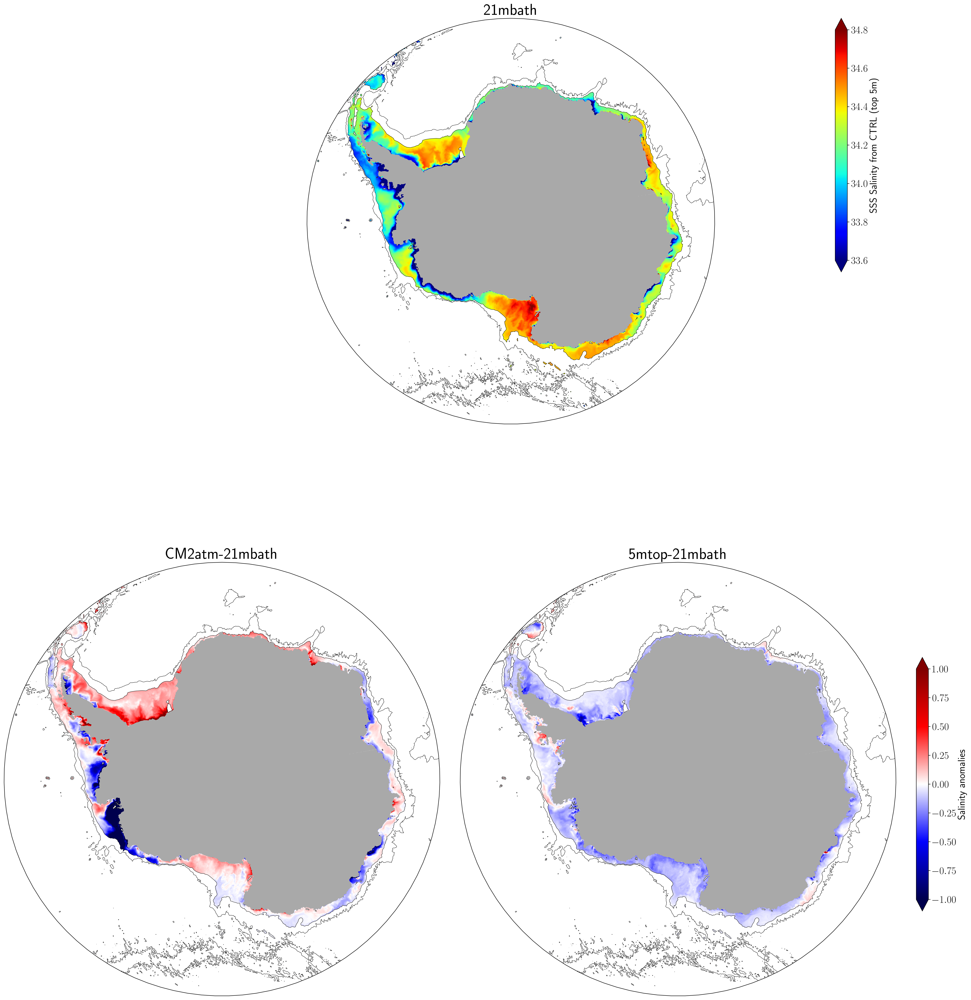

In [23]:
# top salinity comparisson

scale_max = 1
fontsize=18

fig  = plt.figure(1, figsize = (25,25))
norm = col.Normalize(vmin=-scale_max,vmax=scale_max)
normctrl = col.Normalize(vmin=33.6,vmax=34.8)
# Reference Salinity on the Bottom
# setup stereo projection:
ax = fig.add_axes([0.0, 0.6, 1, 0.4],projection=ccrs.SouthPolarStereo())
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)
# plot:
cf = ax.pcolormesh(SSS_21mbath_winter.xt_ocean, SSS_21mbath_winter.yt_ocean, SSS_21mbath_winter + ht_21mbath_mask, norm = normctrl, 
                   cmap = 'jet', transform = ccrs.PlateCarree())
ax.contour(ht_21mbath.xt_ocean,ht_21mbath.yt_ocean,ht_21mbath,levels=[1000,3000],colors='k',linewidths=0.5,transform = ccrs.PlateCarree())
plt.title('21mbath',fontsize=28)
ax.contourf(ht_21mbath.xt_ocean, land_mask_lat_21mbath,land_mask_masked_21mbath,colors='darkgrey',
             zorder=2,transform = ccrs.PlateCarree())
ax.set_extent([-180, 180, -90, -59.5], ccrs.PlateCarree())

# # colorbar:
cbaxes = fig.add_axes([0.82, 0.75, 0.012, 0.25])
cbar = plt.colorbar(cf, cax = cbaxes, orientation = 'vertical',extend = 'both')
cbar.set_label(r'SSS Salinity from CTRL (top 5m)',fontsize=fontsize,labelpad=2)
cbar.ax.tick_params(labelsize=fontsize)





# CM2atm - 21mbath
# setup stereo projection:
ax = fig.add_axes([0, 0.0, 0.43, 0.5],projection=ccrs.SouthPolarStereo())
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)
# plot:
cf = ax.pcolormesh(SSS_CM2atm_winter.xt_ocean, SSS_CM2atm_winter.yt_ocean, SSS_CM2atm_winter - SSS_21mbath_winter + ht_21mbath_mask, norm = norm, 
                   cmap = 'seismic', transform = ccrs.PlateCarree())
ax.contour(ht_21mbath.xt_ocean,ht_21mbath.yt_ocean,ht_21mbath,levels=[1000,3000],colors='k',linewidths=0.5,transform = ccrs.PlateCarree())
plt.title('CM2atm-21mbath',fontsize=28)
ax.contourf(ht_21mbath.xt_ocean, land_mask_lat_21mbath,land_mask_masked_21mbath,colors='darkgrey',
             zorder=2,transform = ccrs.PlateCarree())
ax.set_extent([-180, 180, -90, -59.5], ccrs.PlateCarree())


# 5mtop- 21mbath
# setup stereo projection:
ax = fig.add_axes([0.45, 0.0, 0.43, 0.5],projection=ccrs.SouthPolarStereo())
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)
# plot:
cf2 = ax.pcolormesh(SSS_5mtop_winter.xt_ocean, SSS_5mtop_winter.yt_ocean, SSS_5mtop_winter - SSS_21mbath_winter + ht_21mbath_mask, norm = norm, 
                   cmap = 'seismic', transform = ccrs.PlateCarree())
ax.contour(ht_5mtop.xt_ocean,ht_5mtop.yt_ocean,ht_5mtop,levels=[1000,3000],colors='k',linewidths=0.5,transform = ccrs.PlateCarree())
plt.title('5mtop-21mbath',fontsize=28)
ax.contourf(ht_5mtop.xt_ocean, land_mask_lat_5mtop,land_mask_masked_5mtop,colors='darkgrey',
             zorder=2,transform = ccrs.PlateCarree())
ax.set_extent([-180, 180, -90, -59.5], ccrs.PlateCarree())

cbaxes2 = fig.add_axes([0.9, 0.12, 0.012, 0.25])
cbar2 = plt.colorbar(cf2, cax = cbaxes2, orientation = 'vertical',extend = 'both')
cbar2.set_label(r'Salinity anomalies ',fontsize=fontsize,labelpad=2)
cbar2.ax.tick_params(labelsize=fontsize)


plt.savefig(figpath+'SSS5m_wintersalinity_ontheshelf.png',dpi=300)

The signal we see in the surface waters seems to somewhat reflect what we see in the bottom salinity. This is one more step into following the thread of changes in DSW formation. Until now we see that...

**CM2atm** : Has enhanced DSW formation when compared with 21mbath -->  SWMT on the shelf hints that enhanced DSW is driven by salt fluxes --> Salinities on the bottom of the Antarctic Shelf are bigger in CM2atm --> Tracking back to the surface, SSS (top 5m) are bigger on the Weddell Sea in CM2atm.

**5mtop** : Has weaker DSW formation than the control 21mbath --> SWMT shows a shift towards lighter waters driven by salt fluxes --> The whole bttom of the Antarctic shelf is fresher on 5mtop --> as well as the surface 5 m.


Next setp is to check the fluxes at the surface outputed by the model? which one oof them changed? (Sea ice?)


## Surface fluxes comparisson

We will comapre the differente salt/freshwater surface fluxes we have outputs by the simulation and check which of them changes the most between simulations. OUr current list of output fluxes are:

	float sfc_salt_flux_coupler(time, yt_ocean, xt_ocean) ;
		sfc_salt_flux_coupler:long_name = "sfc_salt_flux_coupler: flux from the coupler" ;
		sfc_salt_flux_coupler:units = "kg/(m^2*sec)" 

  	float sfc_salt_flux_ice(time, yt_ocean, xt_ocean) ;
		sfc_salt_flux_ice:long_name = "sfc_salt_flux_ice" ;
		sfc_salt_flux_ice:units = "kg/(m^2*sec)" 

  	float sfc_salt_flux_restore(time, yt_ocean, xt_ocean) ;
		sfc_salt_flux_restore:long_name = "sfc_salt_flux_restore: flux from restoring term" ;
		sfc_salt_flux_restore:units = "kg/(m^2*sec)" 

  	float wfiform(time, yt_ocean, xt_ocean) ;
		wfiform:long_name = "water out of ocean due to ice form (>0 enters ocean)" ;
		wfiform:units = "(kg/m^3)*(m/sec)" 

  	float wfimelt(time, yt_ocean, xt_ocean) ;
		wfimelt:long_name = "water into ocean due to ice melt (>0 enters ocean)" ;
		wfimelt:units = "(kg/m^3)*(m/sec)" 

  	float melt(time, yt_ocean, xt_ocean) ;
		melt:long_name = "water flux transferred with sea ice form/melt (>0 enters ocean)" ;
		melt:units = "(kg/m^3)*(m/sec)" 

In [24]:
#Importiing fluxes, first, sfc_salt_flux_coupler
sflux_21mbath = cc.querying.getvar('01deg_jra55v13_ryf9091_21mbath', 'sfc_salt_flux_coupler', session, frequency='1 monthly',start_time=start_time, end_time=end_time).sel(time=slice(start_time, end_time)).sel(yt_ocean=lat_slice)    
sflux_CM2atm = cc.querying.getvar('01deg_jra55v13_ryf9091_21mbath_CM2atm', 'sfc_salt_flux_coupler', session, frequency='1 monthly',start_time=start_time, end_time=end_time).sel(time=slice(start_time, end_time)).sel(yt_ocean=lat_slice)    
sflux_5mtop = cc.querying.getvar('ryf_5mtoponly', 'sfc_salt_flux_coupler', temp_session, frequency='1 monthly',start_time=start_time, end_time=end_time).sel(time=slice(start_time, end_time)).sel(yt_ocean=lat_slice)    

#Importiing fluxes, first, sfc_salt_flux_ice
sice_21mbath = cc.querying.getvar('01deg_jra55v13_ryf9091_21mbath', 'sfc_salt_flux_ice', session, frequency='1 monthly',start_time=start_time, end_time=end_time).sel(time=slice(start_time, end_time)).sel(yt_ocean=lat_slice)    
sice_CM2atm = cc.querying.getvar('01deg_jra55v13_ryf9091_21mbath_CM2atm', 'sfc_salt_flux_ice', session, frequency='1 monthly',start_time=start_time, end_time=end_time).sel(time=slice(start_time, end_time)).sel(yt_ocean=lat_slice)    
sice_5mtop = cc.querying.getvar('ryf_5mtoponly', 'sfc_salt_flux_ice', temp_session, frequency='1 monthly',start_time=start_time, end_time=end_time).sel(time=slice(start_time, end_time)).sel(yt_ocean=lat_slice)    

#Importiing fluxes, first, sfc_salt_flux_restore
srest_21mbath = cc.querying.getvar('01deg_jra55v13_ryf9091_21mbath', 'sfc_salt_flux_restore', session, frequency='1 monthly',start_time=start_time, end_time=end_time).sel(time=slice(start_time, end_time)).sel(yt_ocean=lat_slice)    
srest_CM2atm = cc.querying.getvar('01deg_jra55v13_ryf9091_21mbath_CM2atm', 'sfc_salt_flux_restore', session, frequency='1 monthly',start_time=start_time, end_time=end_time).sel(time=slice(start_time, end_time)).sel(yt_ocean=lat_slice)    
srest_5mtop = cc.querying.getvar('ryf_5mtoponly', 'sfc_salt_flux_restore', temp_session, frequency='1 monthly',start_time=start_time, end_time=end_time).sel(time=slice(start_time, end_time)).sel(yt_ocean=lat_slice)    


#Importiing fluxes, first, wfiform
wiceform_21mbath = cc.querying.getvar('01deg_jra55v13_ryf9091_21mbath', 'wfiform', session, frequency='1 monthly',start_time=start_time, end_time=end_time).sel(time=slice(start_time, end_time)).sel(yt_ocean=lat_slice)    
wiceform_CM2atm = cc.querying.getvar('01deg_jra55v13_ryf9091_21mbath_CM2atm', 'wfiform', session, frequency='1 monthly',start_time=start_time, end_time=end_time).sel(time=slice(start_time, end_time)).sel(yt_ocean=lat_slice)    
wiceform_5mtop = cc.querying.getvar('ryf_5mtoponly', 'wfiform', temp_session, frequency='1 monthly',start_time=start_time, end_time=end_time).sel(time=slice(start_time, end_time)).sel(yt_ocean=lat_slice)    


#Importiing fluxes, first, wfimelt
wfimelt_21mbath = cc.querying.getvar('01deg_jra55v13_ryf9091_21mbath', 'wfimelt', session, frequency='1 monthly',start_time=start_time, end_time=end_time).sel(time=slice(start_time, end_time)).sel(yt_ocean=lat_slice)    
wfimelt_CM2atm = cc.querying.getvar('01deg_jra55v13_ryf9091_21mbath_CM2atm', 'wfimelt', session, frequency='1 monthly',start_time=start_time, end_time=end_time).sel(time=slice(start_time, end_time)).sel(yt_ocean=lat_slice)    
wfimelt_5mtop = cc.querying.getvar('ryf_5mtoponly', 'wfimelt', temp_session, frequency='1 monthly',start_time=start_time, end_time=end_time).sel(time=slice(start_time, end_time)).sel(yt_ocean=lat_slice)    


#Importiing fluxes, first, wfimelt
wmelt_21mbath = cc.querying.getvar('01deg_jra55v13_ryf9091_21mbath', 'melt', session, frequency='1 monthly',start_time=start_time, end_time=end_time).sel(time=slice(start_time, end_time)).sel(yt_ocean=lat_slice)    
wmelt_CM2atm = cc.querying.getvar('01deg_jra55v13_ryf9091_21mbath_CM2atm', 'melt', session, frequency='1 monthly',start_time=start_time, end_time=end_time).sel(time=slice(start_time, end_time)).sel(yt_ocean=lat_slice)    
wmelt_5mtop = cc.querying.getvar('ryf_5mtoponly', 'melt', temp_session, frequency='1 monthly',start_time=start_time, end_time=end_time).sel(time=slice(start_time, end_time)).sel(yt_ocean=lat_slice)    


Averaged winter values will be:

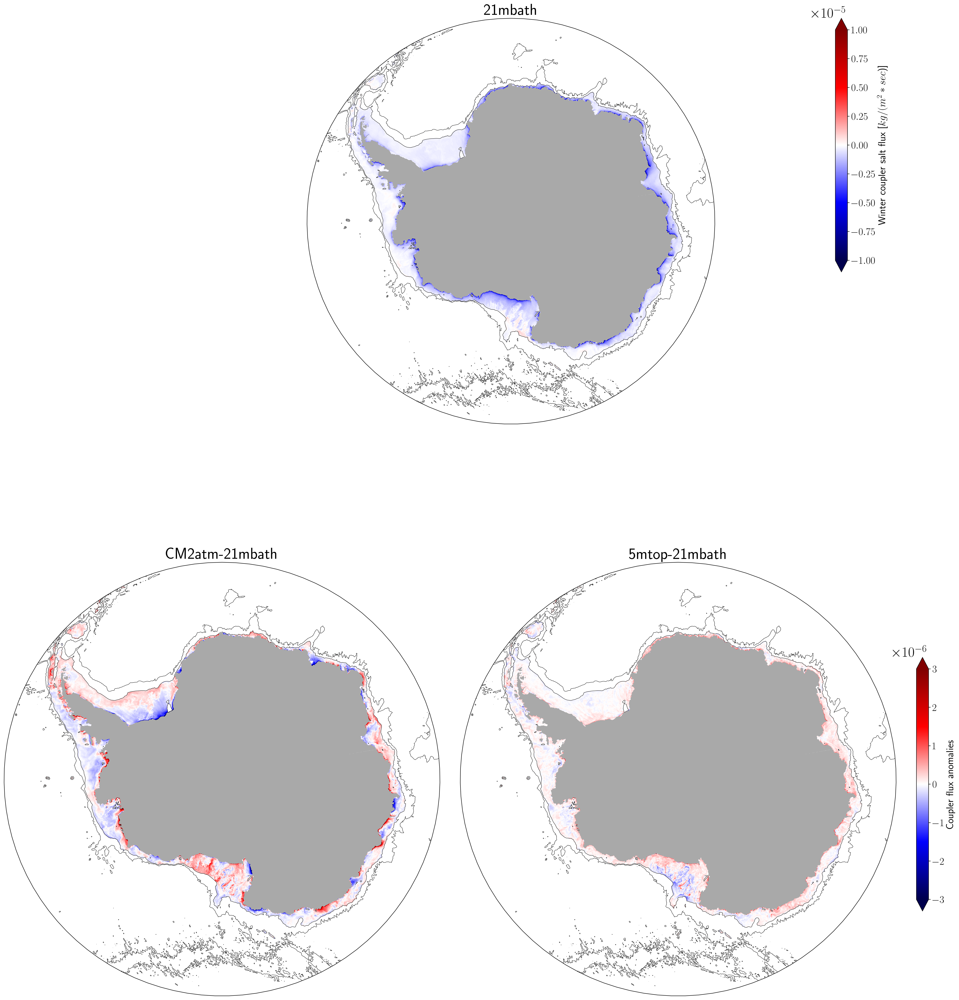

In [25]:
# top coupler flux comparisson

scale_max = 3e-6
fontsize=18

fig  = plt.figure(1, figsize = (25,25))
norm = col.Normalize(vmin=-scale_max,vmax=scale_max)
normctrl = col.Normalize(vmin=-1e-5,vmax=1e-5)
# Reference Salinity on the Bottom
# setup stereo projection:
ax = fig.add_axes([0.0, 0.6, 1, 0.4],projection=ccrs.SouthPolarStereo())
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)
# plot:
cf = ax.pcolormesh(sflux_21mbath.xt_ocean, sflux_21mbath.yt_ocean, sflux_21mbath.isel(time=slice(6,9)).mean('time') + ht_21mbath_mask, norm = normctrl, 
                   cmap = 'seismic', transform = ccrs.PlateCarree())
ax.contour(ht_21mbath.xt_ocean,ht_21mbath.yt_ocean,ht_21mbath,levels=[1000,3000],colors='k',linewidths=0.5,transform = ccrs.PlateCarree())
plt.title('21mbath',fontsize=28)
ax.contourf(ht_21mbath.xt_ocean, land_mask_lat_21mbath,land_mask_masked_21mbath,colors='darkgrey',
             zorder=2,transform = ccrs.PlateCarree())
ax.set_extent([-180, 180, -90, -59.5], ccrs.PlateCarree())

# # colorbar:
cbaxes = fig.add_axes([0.82, 0.75, 0.012, 0.25])
cbar = plt.colorbar(cf, cax = cbaxes, orientation = 'vertical',extend = 'both')
cbar.set_label(r'Winter coupler salt flux  [$kg/(m^2*sec$)]',fontsize=fontsize,labelpad=2)
cbar.ax.tick_params(labelsize=fontsize)





# CM2atm - 21mbath
# setup stereo projection:
ax = fig.add_axes([0, 0.0, 0.43, 0.5],projection=ccrs.SouthPolarStereo())
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)
# plot:
cf = ax.pcolormesh(sflux_CM2atm.xt_ocean, sflux_CM2atm.yt_ocean,  
                   sflux_CM2atm.isel(time=slice(6,9)).mean('time') -  
                   sflux_21mbath.isel(time=slice(6,9)).mean('time') + 
                   ht_21mbath_mask, norm = norm, 
                   cmap = 'seismic', transform = ccrs.PlateCarree())
ax.contour(ht_21mbath.xt_ocean,ht_21mbath.yt_ocean,ht_21mbath,levels=[1000,3000],colors='k',linewidths=0.5,transform = ccrs.PlateCarree())
plt.title('CM2atm-21mbath',fontsize=28)
ax.contourf(ht_21mbath.xt_ocean, land_mask_lat_21mbath,land_mask_masked_21mbath,colors='darkgrey',
             zorder=2,transform = ccrs.PlateCarree())
ax.set_extent([-180, 180, -90, -59.5], ccrs.PlateCarree())


# 5mtop- 21mbath
# setup stereo projection:
ax = fig.add_axes([0.45, 0.0, 0.43, 0.5],projection=ccrs.SouthPolarStereo())
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)
# plot:
cf2 = ax.pcolormesh(sflux_5mtop.xt_ocean, sflux_5mtop.yt_ocean,  
                    sflux_5mtop.isel(time=slice(6,9)).mean('time') -  
                    sflux_21mbath.isel(time=slice(6,9)).mean('time') + 
                    ht_21mbath_mask, norm = norm, 
                   cmap = 'seismic', transform = ccrs.PlateCarree())
ax.contour(ht_5mtop.xt_ocean,ht_5mtop.yt_ocean,ht_5mtop,levels=[1000,3000],colors='k',linewidths=0.5,transform = ccrs.PlateCarree())
plt.title('5mtop-21mbath',fontsize=28)
ax.contourf(ht_5mtop.xt_ocean, land_mask_lat_5mtop,land_mask_masked_5mtop,colors='darkgrey',
             zorder=2,transform = ccrs.PlateCarree())
ax.set_extent([-180, 180, -90, -59.5], ccrs.PlateCarree())

cbaxes2 = fig.add_axes([0.9, 0.12, 0.012, 0.25])
cbar2 = plt.colorbar(cf2, cax = cbaxes2, orientation = 'vertical',extend = 'both')
cbar2.set_label(r'Coupler flux anomalies ',fontsize=fontsize,labelpad=2)
cbar2.ax.tick_params(labelsize=fontsize)


plt.savefig(figpath+'couplerflux_ontheshelf.png',dpi=300)

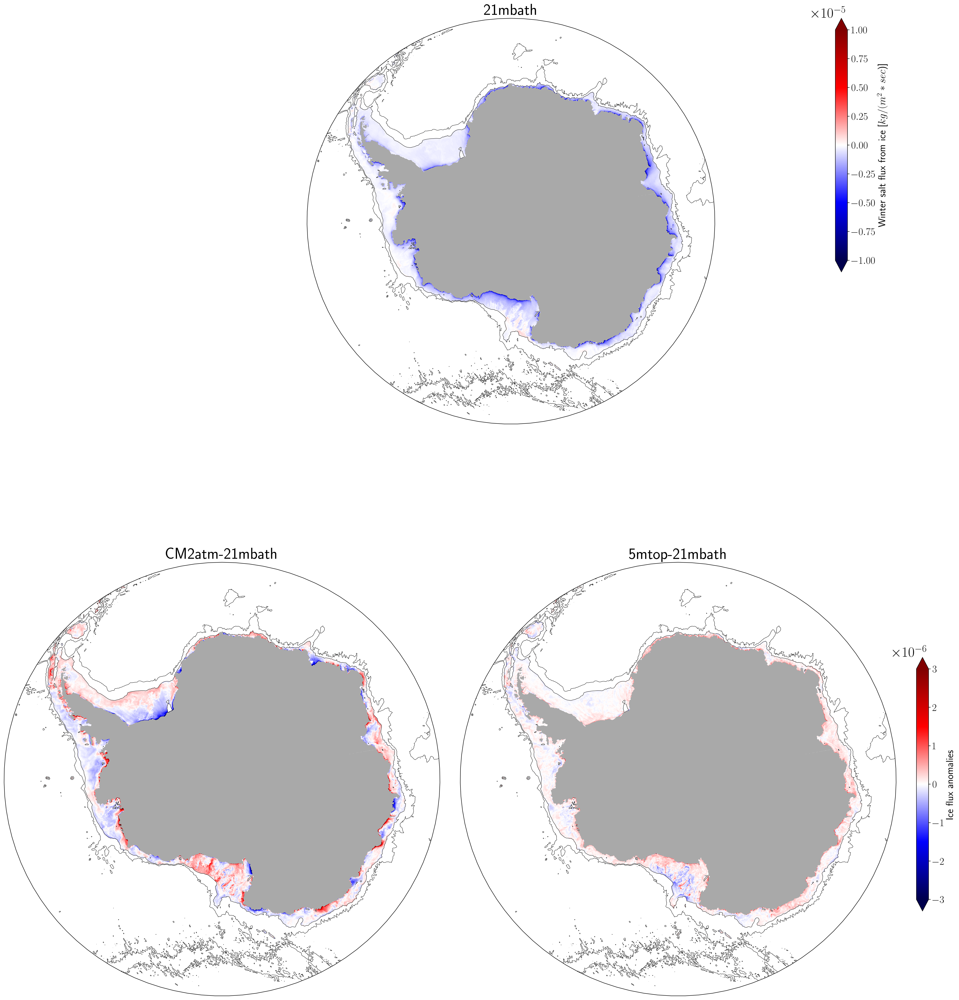

In [26]:
# top ice flux comparisson

scale_max = 3e-6
fontsize=18

fig  = plt.figure(1, figsize = (25,25))
norm = col.Normalize(vmin=-scale_max,vmax=scale_max)
normctrl = col.Normalize(vmin=-1e-5,vmax=1e-5)
# Reference Salinity on the Bottom
# setup stereo projection:
ax = fig.add_axes([0.0, 0.6, 1, 0.4],projection=ccrs.SouthPolarStereo())
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)
# plot:
cf = ax.pcolormesh(sice_21mbath.xt_ocean, sice_21mbath.yt_ocean, sice_21mbath.isel(time=slice(6,9)).mean('time') + ht_21mbath_mask, norm = normctrl, 
                   cmap = 'seismic', transform = ccrs.PlateCarree())
ax.contour(ht_21mbath.xt_ocean,ht_21mbath.yt_ocean,ht_21mbath,levels=[1000,3000],colors='k',linewidths=0.5,transform = ccrs.PlateCarree())
plt.title('21mbath',fontsize=28)
ax.contourf(ht_21mbath.xt_ocean, land_mask_lat_21mbath,land_mask_masked_21mbath,colors='darkgrey',
             zorder=2,transform = ccrs.PlateCarree())
ax.set_extent([-180, 180, -90, -59.5], ccrs.PlateCarree())

# # colorbar:
cbaxes = fig.add_axes([0.82, 0.75, 0.012, 0.25])
cbar = plt.colorbar(cf, cax = cbaxes, orientation = 'vertical',extend = 'both')
cbar.set_label(r'Winter salt flux from ice [$kg/(m^2*sec$)]',fontsize=fontsize,labelpad=2)
cbar.ax.tick_params(labelsize=fontsize)





# CM2atm - 21mbath
# setup stereo projection:
ax = fig.add_axes([0, 0.0, 0.43, 0.5],projection=ccrs.SouthPolarStereo())
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)
# plot:
cf = ax.pcolormesh(sice_CM2atm.xt_ocean, sice_CM2atm.yt_ocean,  
                   sice_CM2atm.isel(time=slice(6,9)).mean('time') -  
                   sice_21mbath.isel(time=slice(6,9)).mean('time') + 
                   ht_21mbath_mask, norm = norm, 
                   cmap = 'seismic', transform = ccrs.PlateCarree())
ax.contour(ht_21mbath.xt_ocean,ht_21mbath.yt_ocean,ht_21mbath,levels=[1000,3000],colors='k',linewidths=0.5,transform = ccrs.PlateCarree())
plt.title('CM2atm-21mbath',fontsize=28)
ax.contourf(ht_21mbath.xt_ocean, land_mask_lat_21mbath,land_mask_masked_21mbath,colors='darkgrey',
             zorder=2,transform = ccrs.PlateCarree())
ax.set_extent([-180, 180, -90, -59.5], ccrs.PlateCarree())


# 5mtop- 21mbath
# setup stereo projection:
ax = fig.add_axes([0.45, 0.0, 0.43, 0.5],projection=ccrs.SouthPolarStereo())
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)
# plot:
cf2 = ax.pcolormesh(sice_5mtop.xt_ocean, sice_5mtop.yt_ocean,  
                    sice_5mtop.isel(time=slice(6,9)).mean('time') -  
                    sice_21mbath.isel(time=slice(6,9)).mean('time') + 
                    ht_21mbath_mask, norm = norm, 
                   cmap = 'seismic', transform = ccrs.PlateCarree())
ax.contour(ht_5mtop.xt_ocean,ht_5mtop.yt_ocean,ht_5mtop,levels=[1000,3000],colors='k',linewidths=0.5,transform = ccrs.PlateCarree())
plt.title('5mtop-21mbath',fontsize=28)
ax.contourf(ht_5mtop.xt_ocean, land_mask_lat_5mtop,land_mask_masked_5mtop,colors='darkgrey',
             zorder=2,transform = ccrs.PlateCarree())
ax.set_extent([-180, 180, -90, -59.5], ccrs.PlateCarree())

cbaxes2 = fig.add_axes([0.9, 0.12, 0.012, 0.25])
cbar2 = plt.colorbar(cf2, cax = cbaxes2, orientation = 'vertical',extend = 'both')
cbar2.set_label(r'Ice flux anomalies ',fontsize=fontsize,labelpad=2)
cbar2.ax.tick_params(labelsize=fontsize)


plt.savefig(figpath+'sice_ontheshelf.png',dpi=300)

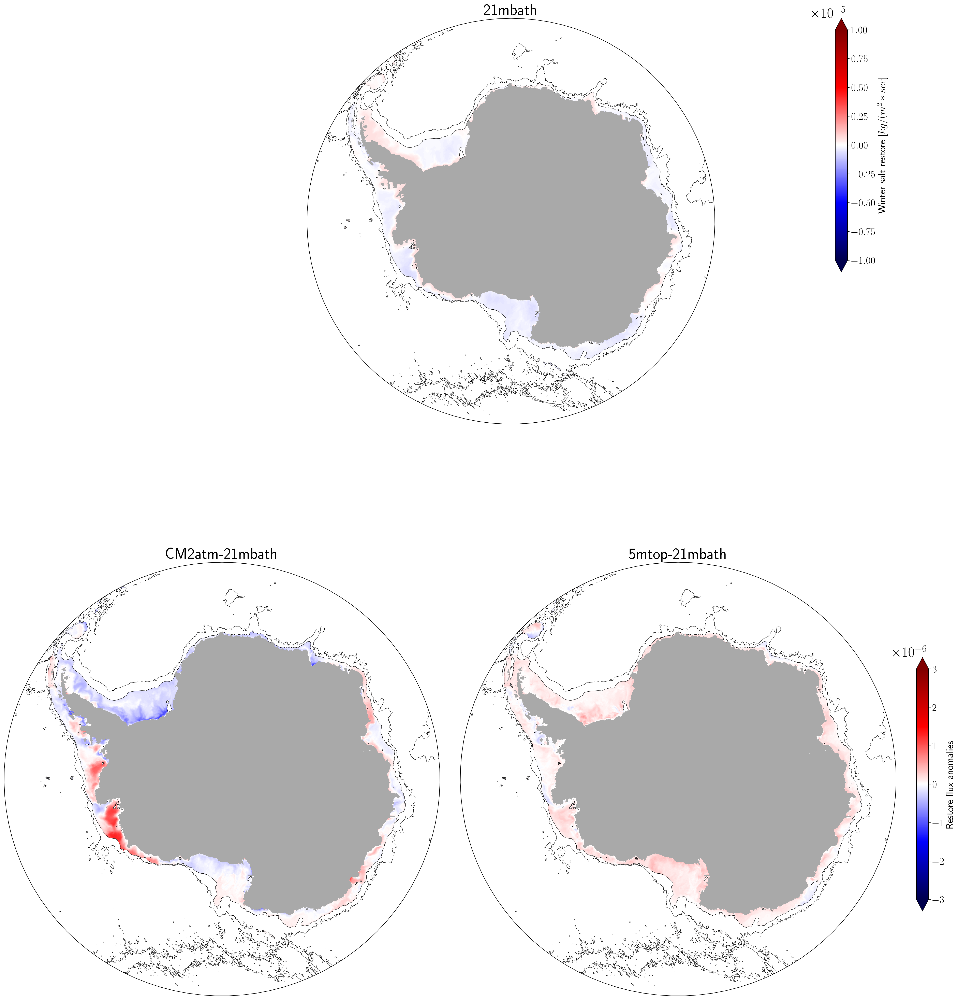

In [27]:
# top restore flux comparisson

scale_max = 3e-6
fontsize=18

fig  = plt.figure(1, figsize = (25,25))
norm = col.Normalize(vmin=-scale_max,vmax=scale_max)
normctrl = col.Normalize(vmin=-1e-5,vmax=1e-5)
# Reference Salinity on the Bottom
# setup stereo projection:
ax = fig.add_axes([0.0, 0.6, 1, 0.4],projection=ccrs.SouthPolarStereo())
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)
# plot:
cf = ax.pcolormesh(srest_21mbath.xt_ocean, srest_21mbath.yt_ocean, srest_21mbath.isel(time=slice(6,9)).mean('time') + ht_21mbath_mask, norm = normctrl, 
                   cmap = 'seismic', transform = ccrs.PlateCarree())
ax.contour(ht_21mbath.xt_ocean,ht_21mbath.yt_ocean,ht_21mbath,levels=[1000,3000],colors='k',linewidths=0.5,transform = ccrs.PlateCarree())
plt.title('21mbath',fontsize=28)
ax.contourf(ht_21mbath.xt_ocean, land_mask_lat_21mbath,land_mask_masked_21mbath,colors='darkgrey',
             zorder=2,transform = ccrs.PlateCarree())
ax.set_extent([-180, 180, -90, -59.5], ccrs.PlateCarree())

# # colorbar:
cbaxes = fig.add_axes([0.82, 0.75, 0.012, 0.25])
cbar = plt.colorbar(cf, cax = cbaxes, orientation = 'vertical',extend = 'both')
cbar.set_label(r'Winter salt restore [$kg/(m^2*sec$]',fontsize=fontsize,labelpad=2)
cbar.ax.tick_params(labelsize=fontsize)





# CM2atm - 21mbath
# setup stereo projection:
ax = fig.add_axes([0, 0.0, 0.43, 0.5],projection=ccrs.SouthPolarStereo())
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)
# plot:
cf = ax.pcolormesh(srest_CM2atm.xt_ocean, srest_CM2atm.yt_ocean,  
                   srest_CM2atm.isel(time=slice(6,9)).mean('time') -  
                   srest_21mbath.isel(time=slice(6,9)).mean('time') + 
                   ht_21mbath_mask, norm = norm, 
                   cmap = 'seismic', transform = ccrs.PlateCarree())
ax.contour(ht_21mbath.xt_ocean,ht_21mbath.yt_ocean,ht_21mbath,levels=[1000,3000],colors='k',linewidths=0.5,transform = ccrs.PlateCarree())
plt.title('CM2atm-21mbath',fontsize=28)
ax.contourf(ht_21mbath.xt_ocean, land_mask_lat_21mbath,land_mask_masked_21mbath,colors='darkgrey',
             zorder=2,transform = ccrs.PlateCarree())
ax.set_extent([-180, 180, -90, -59.5], ccrs.PlateCarree())


# 5mtop- 21mbath
# setup stereo projection:
ax = fig.add_axes([0.45, 0.0, 0.43, 0.5],projection=ccrs.SouthPolarStereo())
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)
# plot:
cf2 = ax.pcolormesh(srest_5mtop.xt_ocean, srest_5mtop.yt_ocean,  
                    srest_5mtop.isel(time=slice(6,9)).mean('time') -  
                    srest_21mbath.isel(time=slice(6,9)).mean('time') + 
                    ht_21mbath_mask, norm = norm, 
                   cmap = 'seismic', transform = ccrs.PlateCarree())
ax.contour(ht_5mtop.xt_ocean,ht_5mtop.yt_ocean,ht_5mtop,levels=[1000,3000],colors='k',linewidths=0.5,transform = ccrs.PlateCarree())
plt.title('5mtop-21mbath',fontsize=28)
ax.contourf(ht_5mtop.xt_ocean, land_mask_lat_5mtop,land_mask_masked_5mtop,colors='darkgrey',
             zorder=2,transform = ccrs.PlateCarree())
ax.set_extent([-180, 180, -90, -59.5], ccrs.PlateCarree())

cbaxes2 = fig.add_axes([0.9, 0.12, 0.012, 0.25])
cbar2 = plt.colorbar(cf2, cax = cbaxes2, orientation = 'vertical',extend = 'both')
cbar2.set_label(r'Restore flux anomalies ',fontsize=fontsize,labelpad=2)
cbar2.ax.tick_params(labelsize=fontsize)


plt.savefig(figpath+'srest_ontheshelf.png',dpi=300)

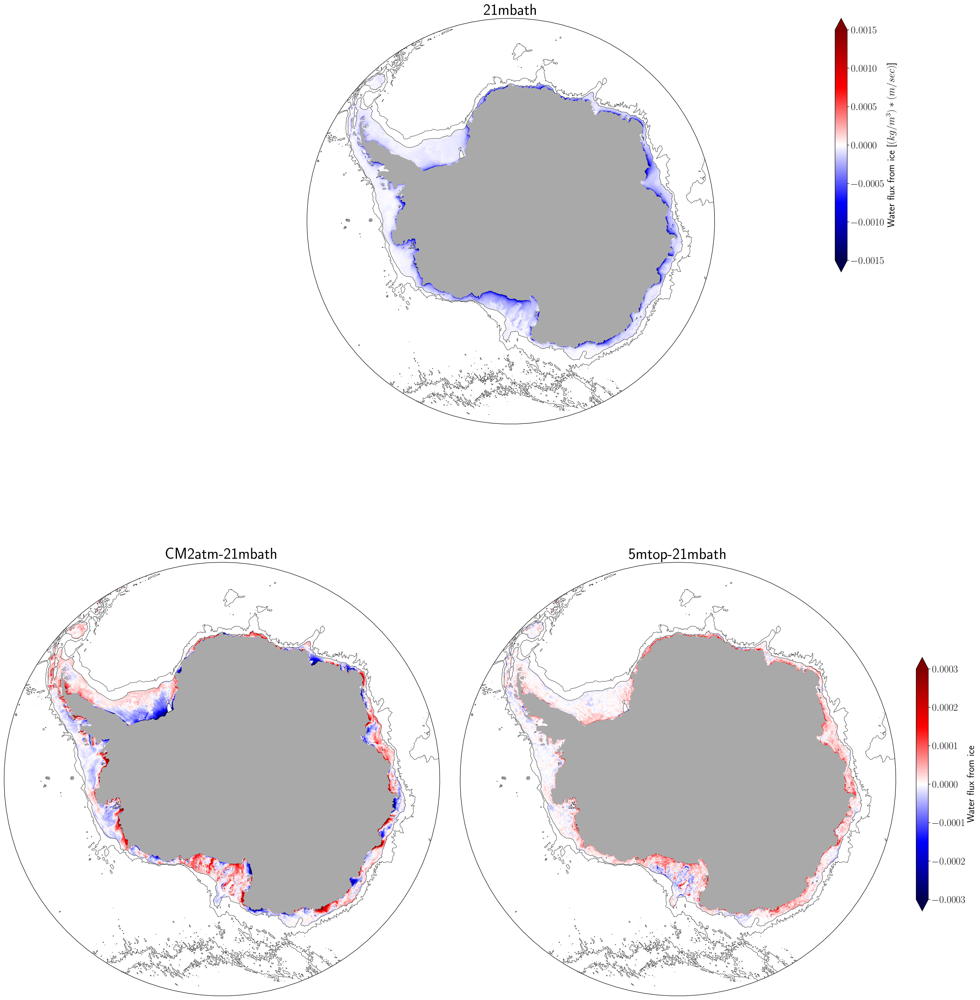

In [28]:
# top wfiform comparisson ( Water out of the ocean due to ice)

scale_max = 3e-4
fontsize=18

fig  = plt.figure(1, figsize = (25,25))
norm = col.Normalize(vmin=-scale_max,vmax=scale_max)
normctrl = col.Normalize(vmin=-0.0015,vmax=0.0015)
# Reference Salinity on the Bottom
# setup stereo projection:
ax = fig.add_axes([0.0, 0.6, 1, 0.4],projection=ccrs.SouthPolarStereo())
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)
# plot:
cf = ax.pcolormesh(wiceform_21mbath.xt_ocean, wiceform_21mbath.yt_ocean, wiceform_21mbath.isel(time=slice(6,9)).mean('time') + ht_21mbath_mask, norm = normctrl, 
                   cmap = 'seismic', transform = ccrs.PlateCarree())
ax.contour(ht_21mbath.xt_ocean,ht_21mbath.yt_ocean,ht_21mbath,levels=[1000,3000],colors='k',linewidths=0.5,transform = ccrs.PlateCarree())
plt.title('21mbath',fontsize=28)
ax.contourf(ht_21mbath.xt_ocean, land_mask_lat_21mbath,land_mask_masked_21mbath,colors='darkgrey',
             zorder=2,transform = ccrs.PlateCarree())
ax.set_extent([-180, 180, -90, -59.5], ccrs.PlateCarree())

# # colorbar:
cbaxes = fig.add_axes([0.82, 0.75, 0.012, 0.25])
cbar = plt.colorbar(cf, cax = cbaxes, orientation = 'vertical',extend = 'both')
cbar.set_label(r'Water flux from ice [$(kg/m^3)*(m/sec)$]',fontsize=fontsize,labelpad=2)
cbar.ax.tick_params(labelsize=fontsize)





# CM2atm - 21mbath
# setup stereo projection:
ax = fig.add_axes([0, 0.0, 0.43, 0.5],projection=ccrs.SouthPolarStereo())
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)
# plot:
cf = ax.pcolormesh(wiceform_CM2atm.xt_ocean, wiceform_CM2atm.yt_ocean,  
                   wiceform_CM2atm.isel(time=slice(6,9)).mean('time') -  
                   wiceform_21mbath.isel(time=slice(6,9)).mean('time') + 
                   ht_21mbath_mask, norm = norm, 
                   cmap = 'seismic', transform = ccrs.PlateCarree())
ax.contour(ht_21mbath.xt_ocean,ht_21mbath.yt_ocean,ht_21mbath,levels=[1000,3000],colors='k',linewidths=0.5,transform = ccrs.PlateCarree())
plt.title('CM2atm-21mbath',fontsize=28)
ax.contourf(ht_21mbath.xt_ocean, land_mask_lat_21mbath,land_mask_masked_21mbath,colors='darkgrey',
             zorder=2,transform = ccrs.PlateCarree())
ax.set_extent([-180, 180, -90, -59.5], ccrs.PlateCarree())


# 5mtop- 21mbath
# setup stereo projection:
ax = fig.add_axes([0.45, 0.0, 0.43, 0.5],projection=ccrs.SouthPolarStereo())
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)
# plot:
cf2 = ax.pcolormesh(wiceform_5mtop.xt_ocean, wiceform_5mtop.yt_ocean,  
                    wiceform_5mtop.isel(time=slice(6,9)).mean('time') -  
                    wiceform_21mbath.isel(time=slice(6,9)).mean('time') + 
                    ht_21mbath_mask, norm = norm, 
                   cmap = 'seismic', transform = ccrs.PlateCarree())
ax.contour(ht_5mtop.xt_ocean,ht_5mtop.yt_ocean,ht_5mtop,levels=[1000,3000],colors='k',linewidths=0.5,transform = ccrs.PlateCarree())
plt.title('5mtop-21mbath',fontsize=28)
ax.contourf(ht_5mtop.xt_ocean, land_mask_lat_5mtop,land_mask_masked_5mtop,colors='darkgrey',
             zorder=2,transform = ccrs.PlateCarree())
ax.set_extent([-180, 180, -90, -59.5], ccrs.PlateCarree())

cbaxes2 = fig.add_axes([0.9, 0.12, 0.012, 0.25])
cbar2 = plt.colorbar(cf2, cax = cbaxes2, orientation = 'vertical',extend = 'both')
cbar2.set_label(r'Water flux from ice',fontsize=fontsize,labelpad=2)
cbar2.ax.tick_params(labelsize=fontsize)


plt.savefig(figpath+'wiceform_ontheshelf.png',dpi=300)

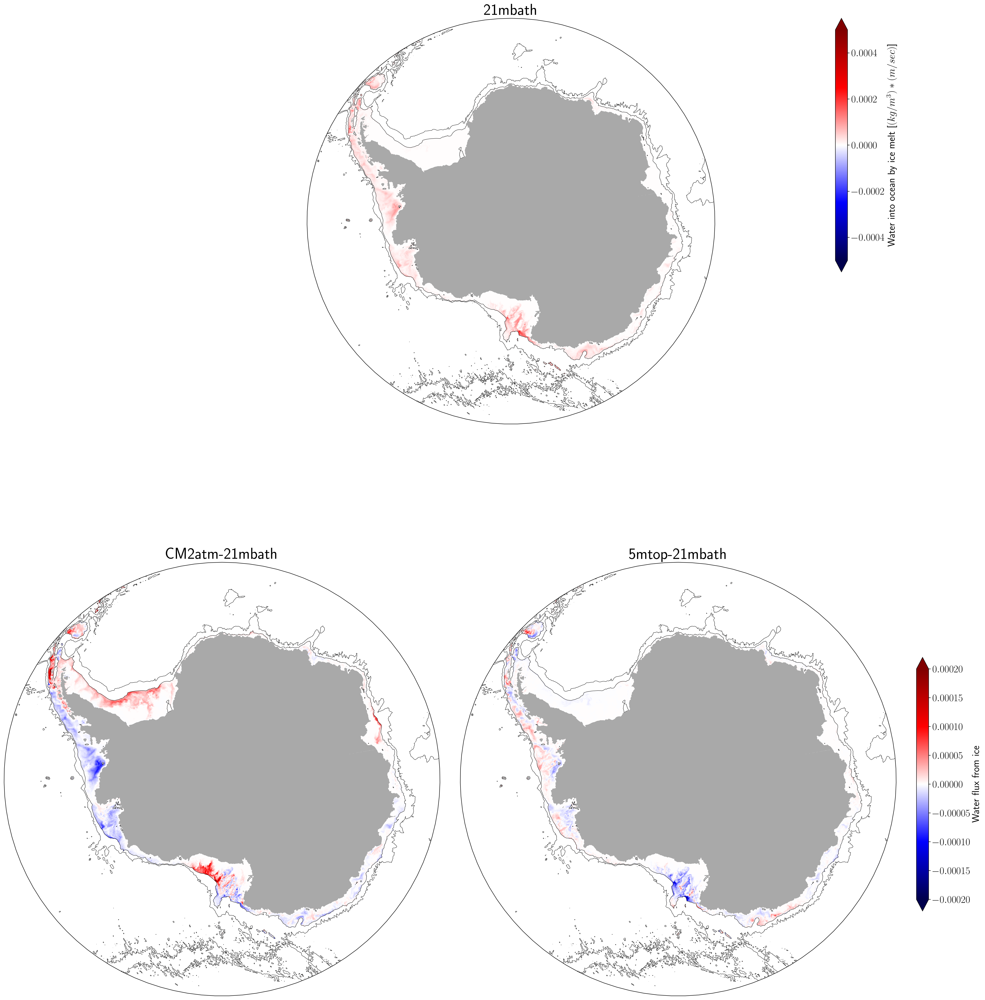

In [29]:
# top wfimelt comparisson ( Water into the ocean due ot ice melt)

scale_max = 2e-4
fontsize=18

fig  = plt.figure(1, figsize = (25,25))
norm = col.Normalize(vmin=-scale_max,vmax=scale_max)
normctrl = col.Normalize(vmin=-0.0005,vmax=0.0005)
# Reference Salinity on the Bottom
# setup stereo projection:
ax = fig.add_axes([0.0, 0.6, 1, 0.4],projection=ccrs.SouthPolarStereo())
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)
# plot:
cf = ax.pcolormesh(wfimelt_21mbath.xt_ocean, wfimelt_21mbath.yt_ocean, wfimelt_21mbath.isel(time=slice(6,9)).mean('time') + ht_21mbath_mask, norm = normctrl, 
                   cmap = 'seismic', transform = ccrs.PlateCarree())
ax.contour(ht_21mbath.xt_ocean,ht_21mbath.yt_ocean,ht_21mbath,levels=[1000,3000],colors='k',linewidths=0.5,transform = ccrs.PlateCarree())
plt.title('21mbath',fontsize=28)
ax.contourf(ht_21mbath.xt_ocean, land_mask_lat_21mbath,land_mask_masked_21mbath,colors='darkgrey',
             zorder=2,transform = ccrs.PlateCarree())
ax.set_extent([-180, 180, -90, -59.5], ccrs.PlateCarree())

# # colorbar:
cbaxes = fig.add_axes([0.82, 0.75, 0.012, 0.25])
cbar = plt.colorbar(cf, cax = cbaxes, orientation = 'vertical',extend = 'both')
cbar.set_label(r'Water into ocean by ice melt [$(kg/m^3)*(m/sec)$]',fontsize=fontsize,labelpad=2)
cbar.ax.tick_params(labelsize=fontsize)





# CM2atm - 21mbath
# setup stereo projection:
ax = fig.add_axes([0, 0.0, 0.43, 0.5],projection=ccrs.SouthPolarStereo())
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)
# plot:
cf = ax.pcolormesh(wfimelt_CM2atm.xt_ocean, wfimelt_CM2atm.yt_ocean,  
                   wfimelt_CM2atm.isel(time=slice(6,9)).mean('time') -  
                   wfimelt_21mbath.isel(time=slice(6,9)).mean('time') + 
                   ht_21mbath_mask, norm = norm, 
                   cmap = 'seismic', transform = ccrs.PlateCarree())
ax.contour(ht_21mbath.xt_ocean,ht_21mbath.yt_ocean,ht_21mbath,levels=[1000,3000],colors='k',linewidths=0.5,transform = ccrs.PlateCarree())
plt.title('CM2atm-21mbath',fontsize=28)
ax.contourf(ht_21mbath.xt_ocean, land_mask_lat_21mbath,land_mask_masked_21mbath,colors='darkgrey',
             zorder=2,transform = ccrs.PlateCarree())
ax.set_extent([-180, 180, -90, -59.5], ccrs.PlateCarree())


# 5mtop- 21mbath
# setup stereo projection:
ax = fig.add_axes([0.45, 0.0, 0.43, 0.5],projection=ccrs.SouthPolarStereo())
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)
# plot:
cf2 = ax.pcolormesh(wfimelt_5mtop.xt_ocean, wfimelt_5mtop.yt_ocean,  
                    wfimelt_5mtop.isel(time=slice(6,9)).mean('time') -  
                    wfimelt_21mbath.isel(time=slice(6,9)).mean('time') + 
                    ht_21mbath_mask, norm = norm, 
                   cmap = 'seismic', transform = ccrs.PlateCarree())
ax.contour(ht_5mtop.xt_ocean,ht_5mtop.yt_ocean,ht_5mtop,levels=[1000,3000],colors='k',linewidths=0.5,transform = ccrs.PlateCarree())
plt.title('5mtop-21mbath',fontsize=28)
ax.contourf(ht_5mtop.xt_ocean, land_mask_lat_5mtop,land_mask_masked_5mtop,colors='darkgrey',
             zorder=2,transform = ccrs.PlateCarree())
ax.set_extent([-180, 180, -90, -59.5], ccrs.PlateCarree())

cbaxes2 = fig.add_axes([0.9, 0.12, 0.012, 0.25])
cbar2 = plt.colorbar(cf2, cax = cbaxes2, orientation = 'vertical',extend = 'both')
cbar2.set_label(r'Water flux from ice',fontsize=fontsize,labelpad=2)
cbar2.ax.tick_params(labelsize=fontsize)


plt.savefig(figpath+'wfimelt_ontheshelf.png',dpi=300)

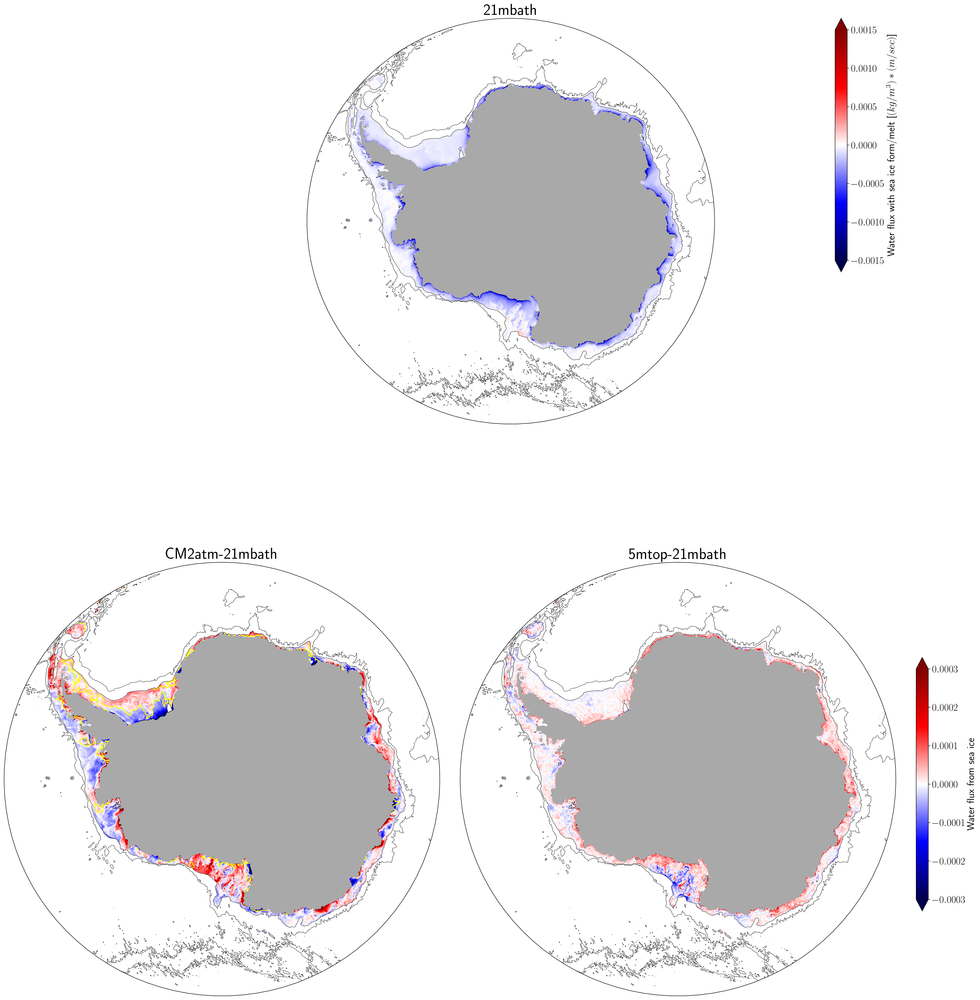

In [30]:
# top wmelt comparisson ( water flux transferred with sea ice form/melt (>0 enters ocean))

scale_max = 3e-4
fontsize=18

fig  = plt.figure(1, figsize = (25,25))
norm = col.Normalize(vmin=-scale_max,vmax=scale_max)
normctrl = col.Normalize(vmin=-0.0015,vmax=0.0015)
# Reference Salinity on the Bottom
# setup stereo projection:
ax = fig.add_axes([0.0, 0.6, 1, 0.4],projection=ccrs.SouthPolarStereo())
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)
# plot:
cf = ax.pcolormesh(wmelt_21mbath.xt_ocean, wmelt_21mbath.yt_ocean, wmelt_21mbath.isel(time=slice(6,9)).mean('time') + ht_21mbath_mask, norm = normctrl, 
                   cmap = 'seismic', transform = ccrs.PlateCarree())
ax.contour(ht_21mbath.xt_ocean,ht_21mbath.yt_ocean,ht_21mbath,levels=[1000,3000],colors='k',linewidths=0.5,transform = ccrs.PlateCarree())
plt.title('21mbath',fontsize=28)
ax.contourf(ht_21mbath.xt_ocean, land_mask_lat_21mbath,land_mask_masked_21mbath,colors='darkgrey',
             zorder=2,transform = ccrs.PlateCarree())
ax.set_extent([-180, 180, -90, -59.5], ccrs.PlateCarree())

# # colorbar:
cbaxes = fig.add_axes([0.82, 0.75, 0.012, 0.25])
cbar = plt.colorbar(cf, cax = cbaxes, orientation = 'vertical',extend = 'both')
cbar.set_label(r'Water flux with sea ice form/melt [$(kg/m^3)*(m/sec)$]',fontsize=fontsize,labelpad=2)
cbar.ax.tick_params(labelsize=fontsize)





# CM2atm - 21mbath
# setup stereo projection:
ax = fig.add_axes([0, 0.0, 0.43, 0.5],projection=ccrs.SouthPolarStereo())
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)
# plot:
cf = ax.pcolormesh(wmelt_CM2atm.xt_ocean, wmelt_CM2atm.yt_ocean,  
                   wmelt_CM2atm.isel(time=slice(6,9)).mean('time') -  
                   wmelt_21mbath.isel(time=slice(6,9)).mean('time') + 
                   ht_21mbath_mask, norm = norm, 
                   cmap = 'seismic', transform = ccrs.PlateCarree())

c_SSS = ax.contour(SSS_CM2atm_winter.xt_ocean, SSS_CM2atm_winter.yt_ocean, SSS_CM2atm_winter - SSS_21mbath_winter+ ht_21mbath_mask,
                   levels=[0.2,15], 
                   colors = 'yellow', transform = ccrs.PlateCarree())

ax.contour(ht_21mbath.xt_ocean,ht_21mbath.yt_ocean,ht_21mbath,levels=[1000,3000],colors='k',linewidths=0.5,transform = ccrs.PlateCarree())
plt.title('CM2atm-21mbath',fontsize=28)
ax.contourf(ht_21mbath.xt_ocean, land_mask_lat_21mbath,land_mask_masked_21mbath,colors='darkgrey',
             zorder=2,transform = ccrs.PlateCarree())
ax.set_extent([-180, 180, -90, -59.5], ccrs.PlateCarree())


# 5mtop- 21mbath
# setup stereo projection:
ax = fig.add_axes([0.45, 0.0, 0.43, 0.5],projection=ccrs.SouthPolarStereo())
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)
# plot:
cf2 = ax.pcolormesh(wmelt_5mtop.xt_ocean, wmelt_5mtop.yt_ocean,  
                    wmelt_5mtop.isel(time=slice(6,9)).mean('time') -  
                    wmelt_21mbath.isel(time=slice(6,9)).mean('time') + 
                    ht_21mbath_mask, norm = norm, 
                   cmap = 'seismic', transform = ccrs.PlateCarree())
ax.contour(ht_5mtop.xt_ocean,ht_5mtop.yt_ocean,ht_5mtop,levels=[1000,3000],colors='k',linewidths=0.5,transform = ccrs.PlateCarree())
plt.title('5mtop-21mbath',fontsize=28)
ax.contourf(ht_5mtop.xt_ocean, land_mask_lat_5mtop,land_mask_masked_5mtop,colors='darkgrey',
             zorder=2,transform = ccrs.PlateCarree())
ax.set_extent([-180, 180, -90, -59.5], ccrs.PlateCarree())

cbaxes2 = fig.add_axes([0.9, 0.12, 0.012, 0.25])
cbar2 = plt.colorbar(cf2, cax = cbaxes2, orientation = 'vertical',extend = 'both')
cbar2.set_label(r'Water flux from sea ice',fontsize=fontsize,labelpad=2)
cbar2.ax.tick_params(labelsize=fontsize)


plt.savefig(figpath+'wmelt_ontheshelf.png',dpi=300)

In the CM2atm anomalies, I overlaid the contour of 0.2 salinity anomaly. YOu can see in the Weddell sea it matches almost perfectly tyhe region with negative anomalies in wmelt. This suggests that surface loss of water due to sea ice formation in winter in Weddell (wmelt negative), is drivint the positive anomalies of salinity in the Weddell Shelf Surface. Which would point out that enhanced sea ice formation in that region is likely causing increase in SSS, sob, and maybe increased DSW formation on Weddell ( and their higher densities)

Before that, I think it would be worth to have ages at the bottom in the same type of maps, lets plot that.

In [31]:
# Importing ages
    #Important detail: for this one we don't want the average of the alst year, 
    #but rather the value on dec 1909 which is the end of the simulation
age_21mbath = cc.querying.getvar('01deg_jra55v13_ryf9091_21mbath', 'age_global', session, frequency='1 monthly',start_time=start_time, end_time=end_time).sel(time=slice(start_time, end_time)).isel(time=-1)    
age_CM2atm = cc.querying.getvar('01deg_jra55v13_ryf9091_21mbath_CM2atm', 'age_global', session, frequency='1 monthly',start_time=start_time, end_time=end_time).sel(time=slice(start_time, end_time)).isel(time=-1) 
age_5mtop = cc.querying.getvar('ryf_5mtoponly', 'age_global', temp_session, frequency='1 monthly',start_time=start_time, end_time=end_time).sel(time=slice(start_time, end_time)).isel(time=-1) 

In [32]:
# 21mbath/ctrl
depth_array = age_21mbath * 0 + age_21mbath.st_ocean
max_depth = depth_array.max(dim = 'st_ocean', skipna= True)
ageob_21mbath = age_21mbath.where(depth_array.st_ocean >= max_depth)
ageob_21mbath = ageob_21mbath.sum(dim = 'st_ocean')


# CM2atm
depth_array = age_CM2atm * 0 + age_CM2atm.st_ocean
max_depth = depth_array.max(dim = 'st_ocean', skipna= True)
ageob_CM2atm = age_CM2atm.where(depth_array.st_ocean >= max_depth)
ageob_CM2atm = ageob_CM2atm.sum(dim = 'st_ocean')


# 5mtop
depth_array = age_5mtop * 0 + age_5mtop.st_ocean
max_depth = depth_array.max(dim = 'st_ocean', skipna= True)
ageob_5mtop = age_5mtop.where(depth_array.st_ocean >= max_depth)
ageob_5mtop = ageob_5mtop.sum(dim = 'st_ocean')

In [33]:
ageob_21mbath=ageob_21mbath.sel(yt_ocean=lat_slice).load()
ageob_CM2atm=ageob_CM2atm.sel(yt_ocean=lat_slice).load()
ageob_5mtop=ageob_5mtop.sel(yt_ocean=lat_slice).load()

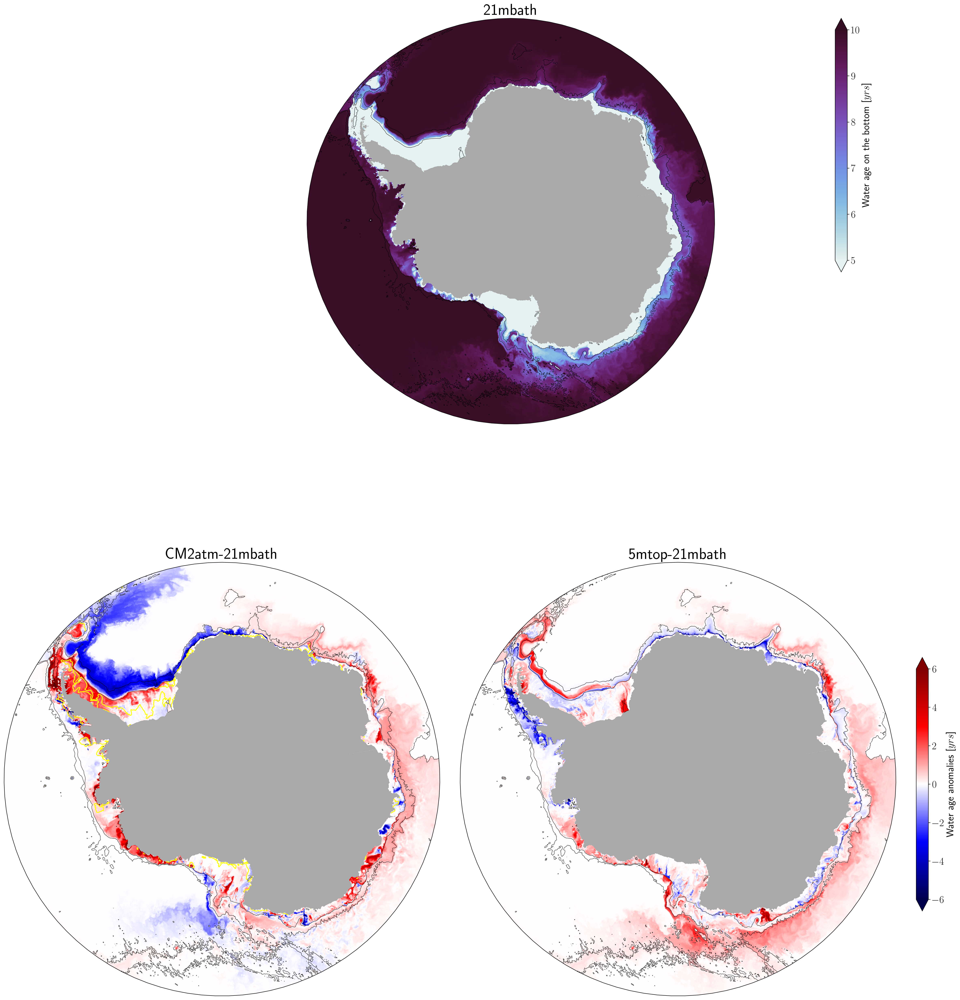

In [34]:
# top wmelt comparisson ( water flux transferred with sea ice form/melt (>0 enters ocean))

scale_max = 6
fontsize=18

fig  = plt.figure(1, figsize = (25,25))
norm = col.Normalize(vmin=-scale_max,vmax=scale_max)
normctrl = col.Normalize(vmin=5,vmax=10)
# Reference Salinity on the Bottom
# setup stereo projection:
ax = fig.add_axes([0.0, 0.6, 1, 0.4],projection=ccrs.SouthPolarStereo())
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)
# plot:
cf = ax.pcolormesh(ageob_21mbath.xt_ocean, ageob_21mbath.yt_ocean, ageob_21mbath , norm = normctrl, 
                   cmap = cmo.dense, transform = ccrs.PlateCarree())
ax.contour(ht_21mbath.xt_ocean,ht_21mbath.yt_ocean,ht_21mbath,levels=[1000,3000],colors='k',linewidths=0.5,transform = ccrs.PlateCarree())
plt.title('21mbath',fontsize=28)
ax.contourf(ht_21mbath.xt_ocean, land_mask_lat_21mbath,land_mask_masked_21mbath,colors='darkgrey',
             zorder=2,transform = ccrs.PlateCarree())
ax.set_extent([-180, 180, -90, -59.5], ccrs.PlateCarree())

# # colorbar:
cbaxes = fig.add_axes([0.82, 0.75, 0.012, 0.25])
cbar = plt.colorbar(cf, cax = cbaxes, orientation = 'vertical',extend = 'both')
cbar.set_label(r' Water age on the bottom [$yrs$]',fontsize=fontsize,labelpad=2)
cbar.ax.tick_params(labelsize=fontsize)





# CM2atm - 21mbath
# setup stereo projection:
ax = fig.add_axes([0, 0.0, 0.43, 0.5],projection=ccrs.SouthPolarStereo())
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)
# plot:
cf = ax.pcolormesh(ageob_CM2atm.xt_ocean, ageob_CM2atm.yt_ocean,  
                   ageob_CM2atm -  
                   ageob_21mbath, norm = norm, 
                   cmap = 'seismic', transform = ccrs.PlateCarree())

c_SSS = ax.contour(SSS_CM2atm_winter.xt_ocean, SSS_CM2atm_winter.yt_ocean, SSS_CM2atm_winter - SSS_21mbath_winter+ ht_21mbath_mask,
                   levels=[0.2,15], 
                   colors = 'yellow', transform = ccrs.PlateCarree())

ax.contour(ht_21mbath.xt_ocean,ht_21mbath.yt_ocean,ht_21mbath,levels=[1000,3000],colors='k',linewidths=0.5,transform = ccrs.PlateCarree())
plt.title('CM2atm-21mbath',fontsize=28)
ax.contourf(ht_21mbath.xt_ocean, land_mask_lat_21mbath,land_mask_masked_21mbath,colors='darkgrey',
             zorder=2,transform = ccrs.PlateCarree())
ax.set_extent([-180, 180, -90, -59.5], ccrs.PlateCarree())


# 5mtop- 21mbath
# setup stereo projection:
ax = fig.add_axes([0.45, 0.0, 0.43, 0.5],projection=ccrs.SouthPolarStereo())
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)
# plot:
cf2 = ax.pcolormesh(ageob_5mtop.xt_ocean, ageob_5mtop.yt_ocean,  
                    ageob_5mtop -  
                    ageob_21mbath, norm = norm, 
                   cmap = 'seismic', transform = ccrs.PlateCarree())
ax.contour(ht_5mtop.xt_ocean,ht_5mtop.yt_ocean,ht_5mtop,levels=[1000,3000],colors='k',linewidths=0.5,transform = ccrs.PlateCarree())
plt.title('5mtop-21mbath',fontsize=28)
ax.contourf(ht_5mtop.xt_ocean, land_mask_lat_5mtop,land_mask_masked_5mtop,colors='darkgrey',
             zorder=2,transform = ccrs.PlateCarree())
ax.set_extent([-180, 180, -90, -59.5], ccrs.PlateCarree())

cbaxes2 = fig.add_axes([0.9, 0.12, 0.012, 0.25])
cbar2 = plt.colorbar(cf2, cax = cbaxes2, orientation = 'vertical',extend = 'both')
cbar2.set_label(r'Water age anomalies [$yrs$]',fontsize=fontsize,labelpad=2)
cbar2.ax.tick_params(labelsize=fontsize)


plt.savefig(figpath+'age_ontheshelf.png',dpi=300)

As we can see, CM2atm has way faster DSW export in the Weddell Sea ( up to 6 years younger waters). The track of new exporting waters actually starts on east Antarctica (aroung 40E long). **So we should zoom in that region and evaluate it further**

(-79.0, -63.0)

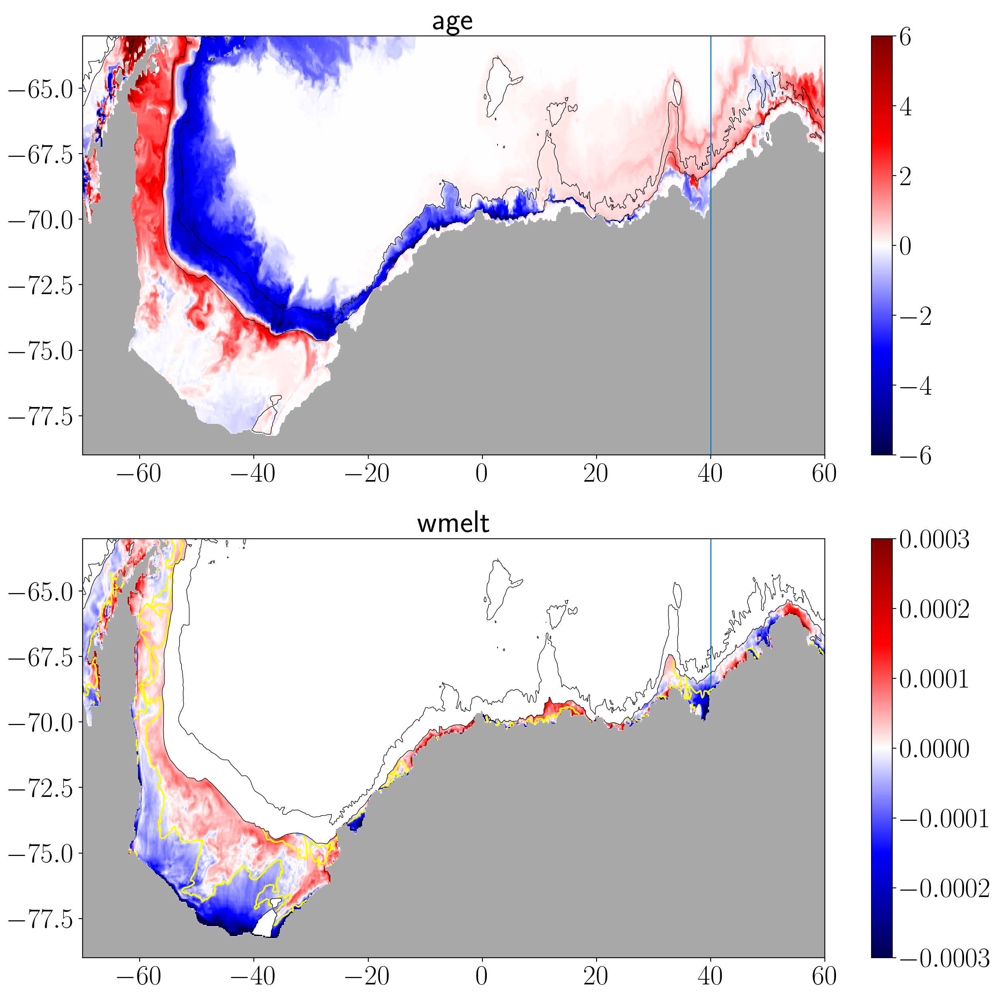

In [35]:
#zoomed into weddell
fig  = plt.figure(1, figsize = (15,15))

plt.subplot(2,1,1)
plt.pcolormesh(ageob_CM2atm.xt_ocean, ageob_CM2atm.yt_ocean,  
                   ageob_CM2atm -  
                   ageob_21mbath, norm = norm, 
                   cmap = 'seismic')
plt.colorbar()
plt.contour(ht_21mbath.xt_ocean,ht_21mbath.yt_ocean,ht_21mbath,levels=[1000,3000],colors='k',linewidths=0.5)
plt.contourf(ht_21mbath.xt_ocean, land_mask_lat_21mbath,land_mask_masked_21mbath,colors='darkgrey',
             zorder=2)
plt.plot([40,40],[-90,-60],linewidth=1)
plt.title('age',fontsize=28)
plt.xlim(-70,60)
plt.ylim(-79,-63)

scale_max = 3e-4
normw = col.Normalize(vmin=-scale_max,vmax=scale_max)
plt.subplot(2,1,2)
plt.pcolormesh(wmelt_CM2atm.xt_ocean, wmelt_CM2atm.yt_ocean,  
                   wmelt_CM2atm.isel(time=slice(6,9)).mean('time') -  
                   wmelt_21mbath.isel(time=slice(6,9)).mean('time') + 
                   ht_21mbath_mask, norm = normw, 
                   cmap = 'seismic')
plt.colorbar()
plt.plot([40,40],[-90,-60],linewidth=1)
plt.contour(SSS_CM2atm_winter.xt_ocean, SSS_CM2atm_winter.yt_ocean, SSS_CM2atm_winter - SSS_21mbath_winter+ ht_21mbath_mask,
                   levels=[0.2,15], 
                   colors = 'yellow')


plt.contour(ht_21mbath.xt_ocean,ht_21mbath.yt_ocean,ht_21mbath,levels=[1000,3000],colors='k',linewidths=0.5)
plt.title('wmelt',fontsize=28)
plt.contourf(ht_21mbath.xt_ocean, land_mask_lat_21mbath,land_mask_masked_21mbath,colors='darkgrey',
             zorder=2)
plt.xlim(-70,60)
plt.ylim(-79,-63)


## Sea Ice production

Next to look for: do we have a variable for sea ice formation? can we plot them somehow?

	float congel_m(time, nj, ni) ;
		congel_m:units = "cm/day" ;
		congel_m:long_name = "congelation ice growth" ;
		congel_m:coordinates = "TLON TLAT time" ;
		congel_m:cell_measures = "area: tarea" ;
		congel_m:missing_value = 1.e+30f ;
		congel_m:_FillValue = 1.e+30f ;
		congel_m:cell_methods = "time: mean" ;
		congel_m:time_rep = "averaged" ;
	float frazil_m(time, nj, ni) ;
		frazil_m:units = "cm/day" ;
		frazil_m:long_name = "frazil ice growth" ;
		frazil_m:coordinates = "TLON TLAT time" ;
		frazil_m:cell_measures = "area: tarea" ;
		frazil_m:missing_value = 1.e+30f ;
		frazil_m:_FillValue = 1.e+30f ;
		frazil_m:cell_methods = "time: mean" ;
		frazil_m:time_rep = "averaged" ;


In [36]:
# Sea ice variables
Congel_21mbath = cc.querying.getvar('01deg_jra55v13_ryf9091_21mbath', 'congel_m', session, frequency='1 monthly',start_time=start_time, end_time=end_time).sel(time=slice(start_time, end_time)).isel(time=slice(6,9)).isel(nj=slice(0,666)).mean('time')    
Congel_CM2atm = cc.querying.getvar('01deg_jra55v13_ryf9091_21mbath_CM2atm', 'congel_m', session, frequency='1 monthly',start_time=start_time, end_time=end_time).sel(time=slice(start_time, end_time)).isel(time=slice(6,9)).isel(nj=slice(0,666)).mean('time') 
Congel_5mtop = cc.querying.getvar('ryf_5mtoponly', 'congel_m', temp_session, frequency='1 monthly',start_time=start_time, end_time=end_time).sel(time=slice(start_time, end_time)).isel(time=slice(6,9)).isel(nj=slice(0,666)).mean('time')  

frazil_21mbath = cc.querying.getvar('01deg_jra55v13_ryf9091_21mbath', 'frazil_m', session, frequency='1 monthly',start_time=start_time, end_time=end_time).sel(time=slice(start_time, end_time)).isel(time=slice(6,9)).isel(nj=slice(0,666)).mean('time')    
frazil_CM2atm = cc.querying.getvar('01deg_jra55v13_ryf9091_21mbath_CM2atm', 'frazil_m', session, frequency='1 monthly',start_time=start_time, end_time=end_time).sel(time=slice(start_time, end_time)).isel(time=slice(6,9)).isel(nj=slice(0,666)).mean('time') 
frazil_5mtop = cc.querying.getvar('ryf_5mtoponly', 'frazil_m', temp_session, frequency='1 monthly',start_time=start_time, end_time=end_time).sel(time=slice(start_time, end_time)).isel(time=slice(6,9)).isel(nj=slice(0,666)).mean('time')  

Icegrowth_21mbath=Congel_21mbath+frazil_21mbath
Icegrowth_CM2atm=Congel_CM2atm+frazil_CM2atm
Icegrowth_5mtop=Congel_5mtop+frazil_5mtop

In [37]:
Icegrowth_21mbath=Icegrowth_21mbath.load()
Icegrowth_CM2atm=Icegrowth_CM2atm.load()
Icegrowth_5mtop=Icegrowth_5mtop.load()

In [38]:
ht_21mbath=ht_21mbath.load()


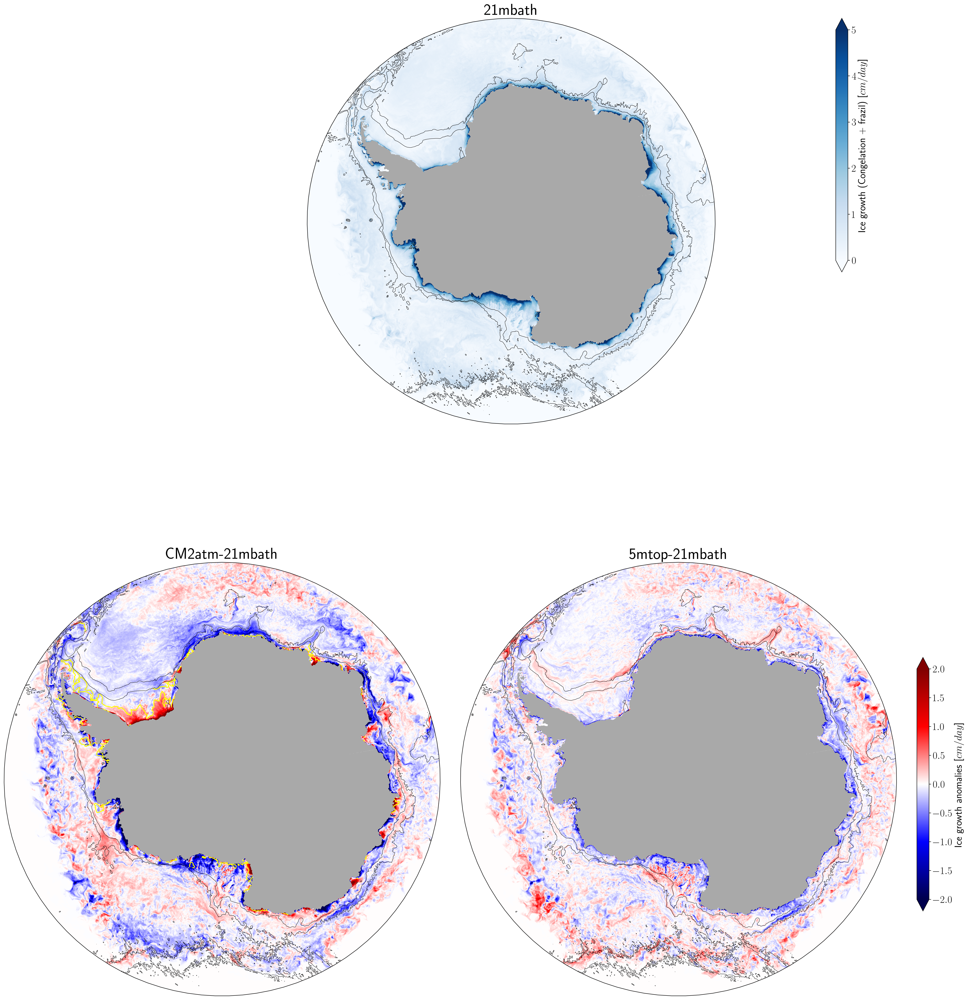

In [39]:
# Congelation + frazil ice growth

scale_max = 2
fontsize=18

fig  = plt.figure(1, figsize = (25,25))
norm = col.Normalize(vmin=-scale_max,vmax=scale_max)
normctrl = col.Normalize(vmin=0,vmax=5)
# Reference Salinity on the Bottom
# setup stereo projection:
ax = fig.add_axes([0.0, 0.6, 1, 0.4],projection=ccrs.SouthPolarStereo())
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)
# plot:
cf = ax.pcolormesh(ht_21mbath.xt_ocean,ht_21mbath.yt_ocean, Icegrowth_21mbath , norm = normctrl, 
                   cmap = 'Blues', transform = ccrs.PlateCarree())
ax.contour(ht_21mbath.xt_ocean,ht_21mbath.yt_ocean,ht_21mbath,levels=[1000,3000],colors='k',linewidths=0.5,transform = ccrs.PlateCarree())
plt.title('21mbath',fontsize=28)
ax.contourf(ht_21mbath.xt_ocean, land_mask_lat_21mbath,land_mask_masked_21mbath,colors='darkgrey',
             zorder=2,transform = ccrs.PlateCarree())
ax.set_extent([-180, 180, -90, -59.5], ccrs.PlateCarree())

# # colorbar:
cbaxes = fig.add_axes([0.82, 0.75, 0.012, 0.25])
cbar = plt.colorbar(cf, cax = cbaxes, orientation = 'vertical',extend = 'both')
cbar.set_label(r' Ice growth (Congelation + frazil) [$cm/day$]',fontsize=fontsize,labelpad=2)
cbar.ax.tick_params(labelsize=fontsize)





# CM2atm - 21mbath
# setup stereo projection:
ax = fig.add_axes([0, 0.0, 0.43, 0.5],projection=ccrs.SouthPolarStereo())
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)
# plot:
cf = ax.pcolormesh(ht_21mbath.xt_ocean, ht_21mbath.yt_ocean,  
                   Icegrowth_CM2atm -  
                   Icegrowth_21mbath, norm = norm, 
                   cmap = 'seismic', transform = ccrs.PlateCarree())

c_SSS = ax.contour(SSS_CM2atm_winter.xt_ocean, SSS_CM2atm_winter.yt_ocean, SSS_CM2atm_winter - SSS_21mbath_winter+ ht_21mbath_mask,
                   levels=[0.2,15], 
                   colors = 'yellow', transform = ccrs.PlateCarree())

ax.contour(ht_21mbath.xt_ocean,ht_21mbath.yt_ocean,ht_21mbath,levels=[1000,3000],colors='k',linewidths=0.5,transform = ccrs.PlateCarree())
plt.title('CM2atm-21mbath',fontsize=28)
ax.contourf(ht_21mbath.xt_ocean, land_mask_lat_21mbath,land_mask_masked_21mbath,colors='darkgrey',
             zorder=2,transform = ccrs.PlateCarree())
ax.set_extent([-180, 180, -90, -59.5], ccrs.PlateCarree())


# 5mtop- 21mbath
# setup stereo projection:
ax = fig.add_axes([0.45, 0.0, 0.43, 0.5],projection=ccrs.SouthPolarStereo())
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)
# plot:
cf2 = ax.pcolormesh(ht_21mbath.xt_ocean, ht_21mbath.yt_ocean,  
                    Icegrowth_5mtop -  
                    Icegrowth_21mbath, norm = norm, 
                   cmap = 'seismic', transform = ccrs.PlateCarree())
ax.contour(ht_5mtop.xt_ocean,ht_5mtop.yt_ocean,ht_5mtop,levels=[1000,3000],colors='k',linewidths=0.5,transform = ccrs.PlateCarree())
plt.title('5mtop-21mbath',fontsize=28)
ax.contourf(ht_5mtop.xt_ocean, land_mask_lat_5mtop,land_mask_masked_5mtop,colors='darkgrey',
             zorder=2,transform = ccrs.PlateCarree())
ax.set_extent([-180, 180, -90, -59.5], ccrs.PlateCarree())

cbaxes2 = fig.add_axes([0.9, 0.12, 0.012, 0.25])
cbar2 = plt.colorbar(cf2, cax = cbaxes2, orientation = 'vertical',extend = 'both')
cbar2.set_label(r'Ice growth anomalies [$cm/day$]',fontsize=fontsize,labelpad=2)
cbar2.ax.tick_params(labelsize=fontsize)


plt.savefig(figpath+'icegrowth_ontheshelf.png',dpi=300)

Interestingly, it seems on CM2atm, the location with stronger ice growth, match well stronger SSS anomalies (on Weddell Sea). So for this simulation it is likely that the stronger Ice growth removed mroe water from the weddell coast, increasing its salinity and density, and allowing more DSW to form. WHat is causing the stronger ice growth? next lets check the winds!

## Wind fields

We will see how the fields tau_x and tau_u change in these locations around the weddell sea

In [40]:
# Sea ice variables
Taux_21mbath = cc.querying.getvar('01deg_jra55v13_ryf9091_21mbath', 'tau_x', session, frequency='1 monthly',start_time=start_time, end_time=end_time).sel(time=slice(start_time, end_time)).isel(time=slice(6,9)).sel(yu_ocean=lat_slice).mean('time')    
Taux_CM2atm = cc.querying.getvar('01deg_jra55v13_ryf9091_21mbath_CM2atm', 'tau_x', session, frequency='1 monthly',start_time=start_time, end_time=end_time).sel(time=slice(start_time, end_time)).isel(time=slice(6,9)).sel(yu_ocean=lat_slice).mean('time') 
Taux_5mtop = cc.querying.getvar('ryf_5mtoponly', 'tau_x', temp_session, frequency='1 monthly',start_time=start_time, end_time=end_time).sel(time=slice(start_time, end_time)).isel(time=slice(6,9)).sel(yu_ocean=lat_slice).mean('time')  

Tauy_21mbath = cc.querying.getvar('01deg_jra55v13_ryf9091_21mbath', 'tau_y', session, frequency='1 monthly',start_time=start_time, end_time=end_time).sel(time=slice(start_time, end_time)).isel(time=slice(6,9)).sel(yu_ocean=lat_slice).mean('time')    
Tauy_CM2atm = cc.querying.getvar('01deg_jra55v13_ryf9091_21mbath_CM2atm', 'tau_y', session, frequency='1 monthly',start_time=start_time, end_time=end_time).sel(time=slice(start_time, end_time)).isel(time=slice(6,9)).sel(yu_ocean=lat_slice).mean('time') 
Tauy_5mtop = cc.querying.getvar('ryf_5mtoponly', 'tau_y', temp_session, frequency='1 monthly',start_time=start_time, end_time=end_time).sel(time=slice(start_time, end_time)).isel(time=slice(6,9)).sel(yu_ocean=lat_slice).mean('time')  

In [41]:
hu_21mbath_mask = cc.querying.getvar('01deg_jra55v13_ryf9091_21mbath','hu' , session,n=1).sel(yu_ocean=slice(-82,-50))
hu_21mbath_mask=hu_21mbath_mask.fillna(0)
hu_21mbath_mask=hu_21mbath_mask.where(hu_21mbath_mask<=1000)*0

In [42]:
# Sea ice variables
Taux_21mbath = Taux_21mbath.load()
Taux_CM2atm = Taux_CM2atm.load()
Taux_5mtop = Taux_5mtop.load()
Tauy_21mbath = Tauy_21mbath.load()
Tauy_CM2atm = Tauy_CM2atm.load()
Tauy_5mtop = Tauy_5mtop.load()
hu_21mbath_mask = hu_21mbath_mask.load()


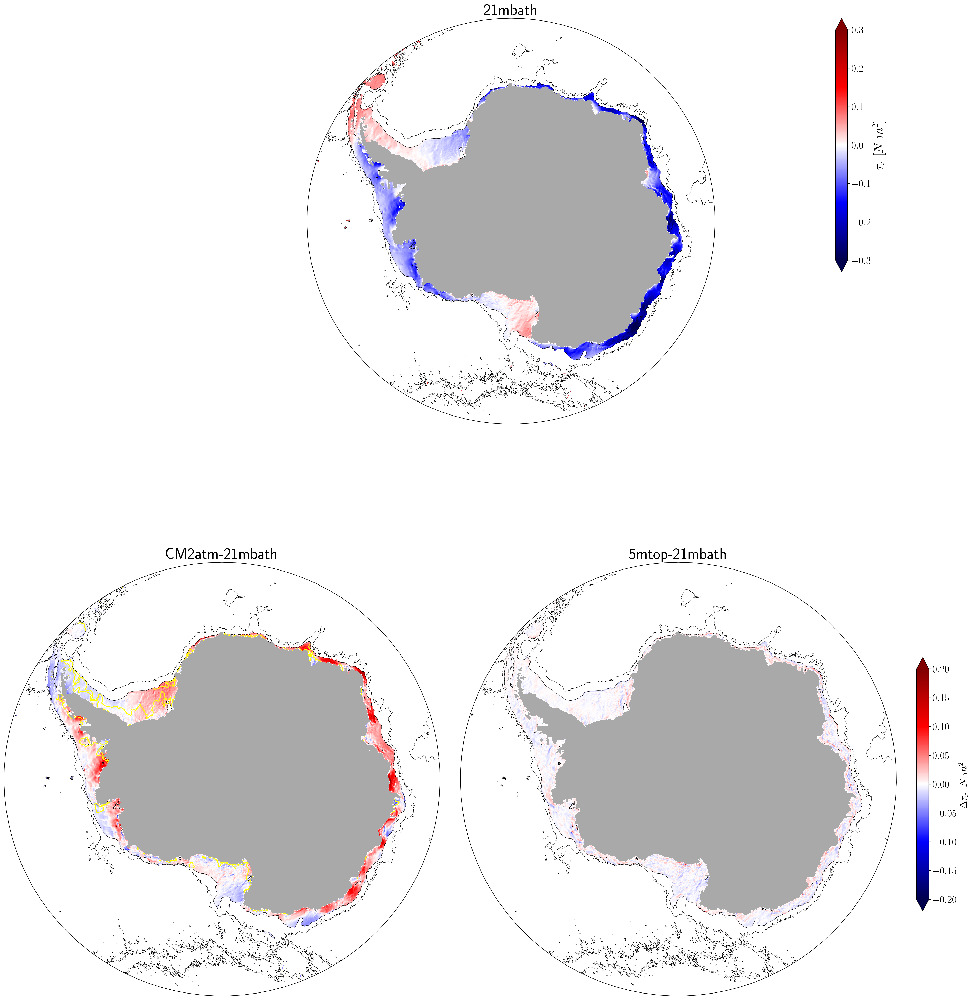

In [43]:
# Taux changes

scale_max = 0.2
fontsize=18

fig  = plt.figure(1, figsize = (25,25))
norm = col.Normalize(vmin=-scale_max,vmax=scale_max)
normctrl = col.Normalize(vmin=-0.3,vmax=0.3)
# Reference Salinity on the Bottom
# setup stereo projection:
ax = fig.add_axes([0.0, 0.6, 1, 0.4],projection=ccrs.SouthPolarStereo())
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)
# plot:
cf = ax.pcolormesh(Taux_21mbath.xu_ocean,Taux_21mbath.yu_ocean, Taux_21mbath + hu_21mbath_mask, norm = normctrl, 
                   cmap = 'seismic', transform = ccrs.PlateCarree())
ax.contour(ht_21mbath.xt_ocean,ht_21mbath.yt_ocean,ht_21mbath,levels=[1000,3000],colors='k',linewidths=0.5,transform = ccrs.PlateCarree())
plt.title('21mbath',fontsize=28)
ax.contourf(ht_21mbath.xt_ocean, land_mask_lat_21mbath,land_mask_masked_21mbath,colors='darkgrey',
             zorder=2,transform = ccrs.PlateCarree())
ax.set_extent([-180, 180, -90, -59.5], ccrs.PlateCarree())

# # colorbar:
cbaxes = fig.add_axes([0.82, 0.75, 0.012, 0.25])
cbar = plt.colorbar(cf, cax = cbaxes, orientation = 'vertical',extend = 'both')
cbar.set_label(r" $\tau_x\ [N\ m^2]$",fontsize=22,labelpad=2)
cbar.ax.tick_params(labelsize=fontsize)





# CM2atm - 21mbath
# setup stereo projection:
ax = fig.add_axes([0, 0.0, 0.43, 0.5],projection=ccrs.SouthPolarStereo())
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)
# plot:
cf = ax.pcolormesh(Taux_CM2atm.xu_ocean, Taux_CM2atm.yu_ocean,  
                   Taux_CM2atm -  
                   Taux_21mbath + hu_21mbath_mask, norm = norm, 
                   cmap = 'seismic', transform = ccrs.PlateCarree())

c_SSS = ax.contour(SSS_CM2atm_winter.xt_ocean, SSS_CM2atm_winter.yt_ocean, SSS_CM2atm_winter - SSS_21mbath_winter+ ht_21mbath_mask,
                   levels=[0.2,15], 
                   colors = 'yellow', transform = ccrs.PlateCarree())

ax.contour(ht_21mbath.xt_ocean,ht_21mbath.yt_ocean,ht_21mbath,levels=[1000,3000],colors='k',linewidths=0.5,transform = ccrs.PlateCarree())
plt.title('CM2atm-21mbath',fontsize=28)
ax.contourf(ht_21mbath.xt_ocean, land_mask_lat_21mbath,land_mask_masked_21mbath,colors='darkgrey',
             zorder=2,transform = ccrs.PlateCarree())
ax.set_extent([-180, 180, -90, -59.5], ccrs.PlateCarree())


# 5mtop- 21mbath
# setup stereo projection:
ax = fig.add_axes([0.45, 0.0, 0.43, 0.5],projection=ccrs.SouthPolarStereo())
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)
# plot:
cf2 = ax.pcolormesh(Taux_5mtop.xu_ocean, Taux_5mtop.yu_ocean,  
                    Taux_5mtop -  
                    Taux_21mbath + hu_21mbath_mask, norm = norm, 
                   cmap = 'seismic', transform = ccrs.PlateCarree())
ax.contour(ht_5mtop.xt_ocean,ht_5mtop.yt_ocean,ht_5mtop,levels=[1000,3000],colors='k',linewidths=0.5,transform = ccrs.PlateCarree())
plt.title('5mtop-21mbath',fontsize=28)
ax.contourf(ht_5mtop.xt_ocean, land_mask_lat_5mtop,land_mask_masked_5mtop,colors='darkgrey',
             zorder=2,transform = ccrs.PlateCarree())
ax.set_extent([-180, 180, -90, -59.5], ccrs.PlateCarree())

cbaxes2 = fig.add_axes([0.9, 0.12, 0.012, 0.25])
cbar2 = plt.colorbar(cf2, cax = cbaxes2, orientation = 'vertical',extend = 'both')
cbar2.set_label(r" $\Delta\tau_x\ [N\ m^2]$",fontsize=fontsize,labelpad=2)
cbar2.ax.tick_params(labelsize=fontsize)


plt.savefig(figpath+'Taux_ontheshelf.png',dpi=300)

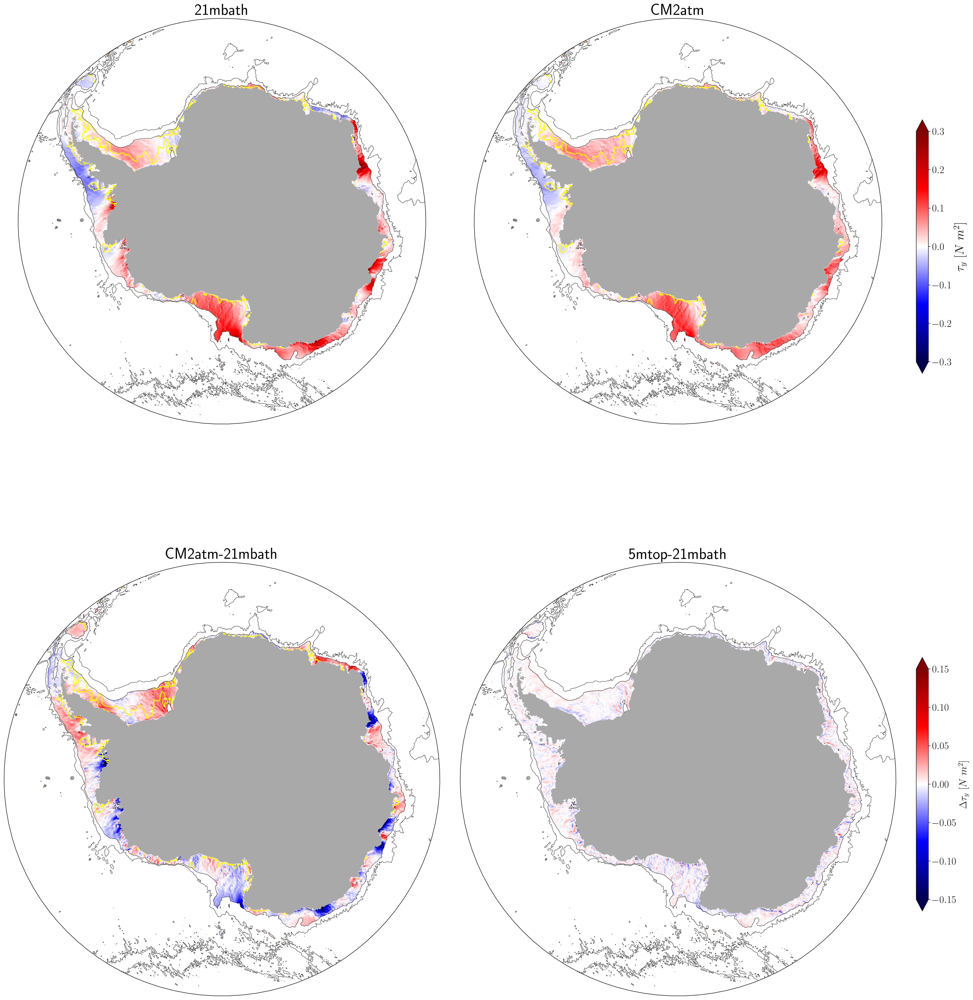

In [44]:
# Tauy changes

scale_max = 0.15
fontsize=18

fig  = plt.figure(1, figsize = (25,25))
norm = col.Normalize(vmin=-scale_max,vmax=scale_max)
normctrl = col.Normalize(vmin=-0.3,vmax=0.3)
# Reference Salinity on the Bottom
# setup stereo projection:
ax = fig.add_axes([0.0, 0.6, 0.43, 0.4],projection=ccrs.SouthPolarStereo())
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)
# plot:
cf = ax.pcolormesh(Tauy_21mbath.xu_ocean,Tauy_21mbath.yu_ocean, Tauy_21mbath + hu_21mbath_mask, norm = normctrl, 
                   cmap = 'seismic', transform = ccrs.PlateCarree())
c_SSS = ax.contour(SSS_CM2atm_winter.xt_ocean, SSS_CM2atm_winter.yt_ocean, SSS_CM2atm_winter - SSS_21mbath_winter+ ht_21mbath_mask,
                   levels=[0.2,15], 
                   colors = 'yellow', transform = ccrs.PlateCarree())
ax.contour(ht_21mbath.xt_ocean,ht_21mbath.yt_ocean,ht_21mbath,levels=[1000,3000],colors='k',linewidths=0.5,transform = ccrs.PlateCarree())
plt.title('21mbath',fontsize=28)
ax.contourf(ht_21mbath.xt_ocean, land_mask_lat_21mbath,land_mask_masked_21mbath,colors='darkgrey',
             zorder=2,transform = ccrs.PlateCarree())
ax.set_extent([-180, 180, -90, -59.5], ccrs.PlateCarree())



ax = fig.add_axes([0.45, 0.6, 0.43, 0.4],projection=ccrs.SouthPolarStereo())
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)
# plot:
cf = ax.pcolormesh(Tauy_CM2atm.xu_ocean,Tauy_CM2atm.yu_ocean, Tauy_CM2atm + hu_21mbath_mask, norm = normctrl, 
                   cmap = 'seismic', transform = ccrs.PlateCarree())
c_SSS = ax.contour(SSS_CM2atm_winter.xt_ocean, SSS_CM2atm_winter.yt_ocean, SSS_CM2atm_winter - SSS_21mbath_winter+ ht_21mbath_mask,
                   levels=[0.2,15], 
                   colors = 'yellow', transform = ccrs.PlateCarree())
ax.contour(ht_21mbath.xt_ocean,ht_21mbath.yt_ocean,ht_21mbath,levels=[1000,3000],colors='k',linewidths=0.5,transform = ccrs.PlateCarree())
plt.title('CM2atm',fontsize=28)
ax.contourf(ht_21mbath.xt_ocean, land_mask_lat_21mbath,land_mask_masked_21mbath,colors='darkgrey',
             zorder=2,transform = ccrs.PlateCarree())
ax.set_extent([-180, 180, -90, -59.5], ccrs.PlateCarree())

# # colorbar:
cbaxes = fig.add_axes([0.9, 0.65, 0.012, 0.25])
cbar = plt.colorbar(cf, cax = cbaxes, orientation = 'vertical',extend = 'both')
cbar.set_label(r" $\tau_y\ [N\ m^2]$",fontsize=22,labelpad=2)
cbar.ax.tick_params(labelsize=fontsize)



# CM2atm - 21mbath
# setup stereo projection:
ax = fig.add_axes([0, 0.0, 0.43, 0.5],projection=ccrs.SouthPolarStereo())
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)
# plot:
cf = ax.pcolormesh(Tauy_CM2atm.xu_ocean, Tauy_CM2atm.yu_ocean,  
                   Tauy_CM2atm -  
                   Tauy_21mbath + hu_21mbath_mask, norm = norm, 
                   cmap = 'seismic', transform = ccrs.PlateCarree())

c_SSS = ax.contour(SSS_CM2atm_winter.xt_ocean, SSS_CM2atm_winter.yt_ocean, SSS_CM2atm_winter - SSS_21mbath_winter+ ht_21mbath_mask,
                   levels=[0.2,15], 
                   colors = 'yellow', transform = ccrs.PlateCarree())

ax.contour(ht_21mbath.xt_ocean,ht_21mbath.yt_ocean,ht_21mbath,levels=[1000,3000],colors='k',linewidths=0.5,transform = ccrs.PlateCarree())
plt.title('CM2atm-21mbath',fontsize=28)
ax.contourf(ht_21mbath.xt_ocean, land_mask_lat_21mbath,land_mask_masked_21mbath,colors='darkgrey',
             zorder=2,transform = ccrs.PlateCarree())
ax.set_extent([-180, 180, -90, -59.5], ccrs.PlateCarree())


# 5mtop- 21mbath
# setup stereo projection:
ax = fig.add_axes([0.45, 0.0, 0.43, 0.5],projection=ccrs.SouthPolarStereo())
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)
# plot:
cf2 = ax.pcolormesh(Tauy_5mtop.xu_ocean, Taux_5mtop.yu_ocean,  
                    Tauy_5mtop -  
                    Tauy_21mbath + hu_21mbath_mask, norm = norm, 
                   cmap = 'seismic', transform = ccrs.PlateCarree())
ax.contour(ht_5mtop.xt_ocean,ht_5mtop.yt_ocean,ht_5mtop,levels=[1000,3000],colors='k',linewidths=0.5,transform = ccrs.PlateCarree())
plt.title('5mtop-21mbath',fontsize=28)
ax.contourf(ht_5mtop.xt_ocean, land_mask_lat_5mtop,land_mask_masked_5mtop,colors='darkgrey',
             zorder=2,transform = ccrs.PlateCarree())
ax.set_extent([-180, 180, -90, -59.5], ccrs.PlateCarree())

cbaxes2 = fig.add_axes([0.9, 0.12, 0.012, 0.25])
cbar2 = plt.colorbar(cf2, cax = cbaxes2, orientation = 'vertical',extend = 'both')
cbar2.set_label(r" $\Delta\tau_y\ [N\ m^2]$",fontsize=fontsize,labelpad=2)
cbar2.ax.tick_params(labelsize=fontsize)


plt.savefig(figpath+'Tauy_ontheshelf.png',dpi=300)

There is a region in eastern Weddell Sea where CM2atm has positive tauy, while 21mbath has negative. Perhaps the positive tauy is increasing the polynya size on Weddell sea, and icreasing DSW formation ( through stronger displacement of sea ice offshore, and stronger sea ice formation). Last step is to check the change in sea ice thickness - is it smaller in that region during winter?

	float hi_m(time, nj, ni) ;
		hi_m:units = "m" ;
		hi_m:long_name = "grid cell mean ice thickness

  	float aice_m(time, nj, ni) ;
		aice_m:units = "1" ;
		aice_m:long_name = "ice area  (aggregate)" ;

	float aicen_m(time, nc, nj, ni) ;
		aicen_m:units = "1" ;
		aicen_m:long_name = "ice area, categories" ;

	float vicen_m(time, nc, nj, ni) ;
		vicen_m:units = "m" ;
		vicen_m:long_name = "ice volume, categories" ;


In [45]:
# Sea ice volume
Vice_21mbath = cc.querying.getvar('01deg_jra55v13_ryf9091_21mbath', 'vicen_m', session, frequency='1 monthly',start_time=start_time, end_time=end_time).sel(time=slice(start_time, end_time)).isel(time=slice(6,9)).isel(nj=slice(0,666)).mean('time').sum('nc')      
Vice_CM2atm = cc.querying.getvar('01deg_jra55v13_ryf9091_21mbath_CM2atm', 'vicen_m', session, frequency='1 monthly',start_time=start_time, end_time=end_time).sel(time=slice(start_time, end_time)).isel(time=slice(6,9)).isel(nj=slice(0,666)).mean('time').sum('nc')   
Vice_5mtop = cc.querying.getvar('ryf_5mtoponly', 'vicen_m', temp_session, frequency='1 monthly',start_time=start_time, end_time=end_time).sel(time=slice(start_time, end_time)).isel(time=slice(6,9)).isel(nj=slice(0,666)).mean('time').sum('nc')  


In [46]:
Vice_21mbath = Vice_21mbath.load()
Vice_CM2atm = Vice_CM2atm.load()
Vice_5mtop = Vice_5mtop.load()

In [ ]:
# Ice volume

scale_max = 4
fontsize=18

fig  = plt.figure(1, figsize = (25,25))
norm = col.Normalize(vmin=-scale_max,vmax=scale_max)
normctrl = col.Normalize(vmin=0,vmax=5)
# Reference Salinity on the Bottom
# setup stereo projection:
ax = fig.add_axes([0.0, 0.6, 1, 0.4],projection=ccrs.SouthPolarStereo())
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)
# plot:
cf = ax.pcolormesh(ht_21mbath.xt_ocean,ht_21mbath.yt_ocean, Vice_21mbath , norm = normctrl, 
                   cmap = 'Blues', transform = ccrs.PlateCarree())
ax.contour(ht_21mbath.xt_ocean,ht_21mbath.yt_ocean,ht_21mbath,levels=[1000,3000],colors='k',linewidths=0.5,transform = ccrs.PlateCarree())
plt.title('21mbath',fontsize=28)
ax.contourf(ht_21mbath.xt_ocean, land_mask_lat_21mbath,land_mask_masked_21mbath,colors='darkgrey',
             zorder=2,transform = ccrs.PlateCarree())
ax.set_extent([-180, 180, -90, -59.5], ccrs.PlateCarree())

# # colorbar:
cbaxes = fig.add_axes([0.82, 0.75, 0.012, 0.25])
cbar = plt.colorbar(cf, cax = cbaxes, orientation = 'vertical',extend = 'both')
cbar.set_label(r' Ice volume [$m$]',fontsize=fontsize,labelpad=2)
cbar.ax.tick_params(labelsize=fontsize)





# CM2atm - 21mbath
# setup stereo projection:
ax = fig.add_axes([0, 0.0, 0.43, 0.5],projection=ccrs.SouthPolarStereo())
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)
# plot:
cf = ax.pcolormesh(ht_21mbath.xt_ocean, ht_21mbath.yt_ocean,  
                   Vice_CM2atm - Vice_21mbath, norm = norm, 
                   cmap = 'seismic', transform = ccrs.PlateCarree())

c_SSS = ax.contour(SSS_CM2atm_winter.xt_ocean, SSS_CM2atm_winter.yt_ocean, SSS_CM2atm_winter - SSS_21mbath_winter+ ht_21mbath_mask,
                   levels=[0.2,15], 
                   colors = 'yellow', transform = ccrs.PlateCarree())

ax.contour(ht_21mbath.xt_ocean,ht_21mbath.yt_ocean,ht_21mbath,levels=[1000,3000],colors='k',linewidths=0.5,transform = ccrs.PlateCarree())
plt.title('CM2atm-21mbath',fontsize=28)
ax.contourf(ht_21mbath.xt_ocean, land_mask_lat_21mbath,land_mask_masked_21mbath,colors='darkgrey',
             zorder=2,transform = ccrs.PlateCarree())
ax.set_extent([-180, 180, -90, -59.5], ccrs.PlateCarree())


# 5mtop- 21mbath
# setup stereo projection:
ax = fig.add_axes([0.45, 0.0, 0.43, 0.5],projection=ccrs.SouthPolarStereo())
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)
# plot:
cf2 = ax.pcolormesh(ht_21mbath.xt_ocean, ht_21mbath.yt_ocean,  
                    Vice_5mtop - Vice_21mbath, norm = norm, 
                   cmap = 'seismic', transform = ccrs.PlateCarree())
ax.contour(ht_5mtop.xt_ocean,ht_5mtop.yt_ocean,ht_5mtop,levels=[1000,3000],colors='k',linewidths=0.5,transform = ccrs.PlateCarree())
plt.title('5mtop-21mbath',fontsize=28)
ax.contourf(ht_5mtop.xt_ocean, land_mask_lat_5mtop,land_mask_masked_5mtop,colors='darkgrey',
             zorder=2,transform = ccrs.PlateCarree())
ax.set_extent([-180, 180, -90, -59.5], ccrs.PlateCarree())

cbaxes2 = fig.add_axes([0.9, 0.12, 0.012, 0.25])
cbar2 = plt.colorbar(cf2, cax = cbaxes2, orientation = 'vertical',extend = 'both')
cbar2.set_label(r'Ice volume anomalies [$m$]',fontsize=fontsize,labelpad=2)
cbar2.ax.tick_params(labelsize=fontsize)


plt.savefig(figpath+'Vice_ontheshelf.png',dpi=300)


OK, the Antarctic Peninsula definitely has lower ice volume. But the signal is greater than that small region I described. Is is possible that other variables would be changing sea ice growth here?

An additional hypothesis is the convergence of taux on the weddell shelf. check the taux on the control simulation (top plot). on the A.P tauxis positive pushing ice to the east, and on  the inner east weddell, taux is negative pushing ice to the east. This would cause an ice convergence in Weddell Sea ( which would hinder further sea ice growth).

Now, notice in the CM2atm tau_x anomaly plots, it  seems that this convergence is decreased. This would allow more heat exchange in the surface, of the weddell sea during winter, and therefore stronger ice growth --> which would increase surface salinities and so on...